## This Notebook Generates Spatial Plots for Market Share and Churn Rate on the given data
## It also predicts the Churn Risk value using a Randome Forest Model

In [3]:
'''
This Notebook Generates Spatial Plots for Market Share and Churn Rate on the given data It also predicts the Churn Risk value using a Randome Forest Model
'''
import numpy as np 
import pandas as pd
import tensorflow as tf
import keras
import sklearn 
import scipy
import matplotlib.pyplot as plt

#### Loading All the Sample Data

In [4]:

path = '/Users/saragolestani/Downloads/Bell/sample_dataset/'


df_sample_demographic = pd.read_csv(path + 'sample_dataset_demographics.csv')
df_sample_location = pd.read_csv(path + 'sample_dataset_location.csv')
df_sample_population = pd.read_csv(path + 'sample_dataset_population.csv')
df_sample_services = pd.read_csv(path + 'sample_dataset_services.csv')
df_sample_status = pd.read_csv(path + 'sample_dataset_status.csv')

#### Take a peack at loaded data

In [5]:
df_sample_demographic.head()

,Customer ID,Gender,Age,Married,Dependents,Number of Dependents
0,1608-GMEWB,Male,76,No,No,0
1,2817-LVCPP,Female,36,No,No,0
2,0997-YTLNY,Female,59,No,Yes,2
3,0526-SXDJP,Male,36,Yes,No,0
4,3466-RITXD,Male,34,No,No,0


In [23]:
df_sample_location.head()

,Customer ID,State,City,Zip Code,Latitude,Longitude
0,4299-OPXEJ,California,Inglewood,90301,33.956445,-118.358634
1,4656-CAURT,California,Phillipsville,95559,40.184094,-123.745487
2,5285-MVEHD,California,Sunnyvale,94087,37.351100,-122.037311
3,7481-ATQQS,California,Boulder Creek,95006,37.171727,-122.142961
4,1707-HABPF,California,Santa Barbara,93103,34.438581,-119.685368


In [24]:
df_sample_population.head()

,Zip Code,Population
0,95366,"12,646"
1,95252,"11,266"
2,92241,"5,529"
3,95225,27
4,92341,317


In [25]:
df_sample_services.head()

,Customer ID,Referred a Friend,Number of Referrals,Tenure in Months,Offer,Home Phone Service,Avg Monthly Long Distance Charges,Multiple Lines,Internet Service,Internet Type,...,Unlimited Data,Contract,Paperless Billing,Payment Method,Monthly Charge,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue
0,1240-HCBOH,No,0,67,NaN,Yes,43.30,Yes,No,NaN,...,No,Two Year,Yes,Credit Card,26.10,1759.55,0.0,0,2901.10,4660.65
1,3744-ZBHON,No,0,3,NaN,Yes,31.81,No,No,NaN,...,No,Month-to-Month,No,Bank Withdrawal,20.20,65.95,0.0,0,95.43,161.38
2,5989-PGKJB,No,0,16,Offer D,Yes,22.30,No,Yes,Fiber Optic,...,Yes,Month-to-Month,Yes,Bank Withdrawal,86.25,1340.10,0.0,0,356.80,1696.90
3,3585-ISXZP,No,0,8,NaN,Yes,29.66,Yes,Yes,Fiber Optic,...,Yes,Month-to-Month,No,Bank Withdrawal,95.65,778.10,0.0,0,237.28,1015.38
4,6728-DKUCO,Yes,1,72,Offer A,Yes,25.82,Yes,Yes,Fiber Optic,...,Yes,One Year,Yes,Bank Withdrawal,104.15,7303.05,0.0,0,1859.04,9162.09


In [26]:
df_sample_status.head()

,Customer ID,Satisfaction Score,Customer Status,Churn Value,Churn Category,Churn Reason
0,3910-MRQOY,3,Stayed,0,NaN,NaN
1,0975-VOOVL,4,Joined,0,NaN,NaN
2,3146-JTQHR,5,Stayed,0,NaN,NaN
3,7767-UXAGJ,3,Churned,1,Competitor,Competitor made better offer
4,5849-ASHZJ,3,Stayed,0,NaN,NaN


### Merging them all in order to start our computations 

In [5]:
# The common Row Between them all is Customer ID 

df_demo_loc = df_sample_location.merge(df_sample_demographic, how = 'inner', on='Customer ID')
df_demo_loc_serv = df_demo_loc.merge(df_sample_services, how = 'inner', on='Customer ID')
df_demo_loc_serv_stat = df_demo_loc_serv.merge(df_sample_status, how = 'inner', on='Customer ID')

In [7]:

df_demo_loc_serv_stat.head()


,Customer ID,State,City,Zip Code,Latitude,Longitude,Gender,Age,Married,Dependents,...,Total Charges,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Satisfaction Score,Customer Status,Churn Value,Churn Category,Churn Reason
0,4299-OPXEJ,California,Inglewood,90301,33.956445,-118.358634,Female,57,No,No,...,1080.55,0.0,0,777.84,1858.39,5,Stayed,0,NaN,NaN
1,4656-CAURT,California,Phillipsville,95559,40.184094,-123.745487,Male,57,No,No,...,1713.10,0.0,0,1534.56,3247.66,3,Stayed,0,NaN,NaN
2,5285-MVEHD,California,Sunnyvale,94087,37.351100,-122.037311,Female,35,Yes,No,...,6068.65,0.0,0,1909.60,7978.25,4,Stayed,0,NaN,NaN
3,7481-ATQQS,California,Boulder Creek,95006,37.171727,-122.142961,Female,76,No,No,...,4515.85,0.0,0,2199.12,6714.97,2,Churned,1,Attitude,Attitude of support person
4,1707-HABPF,California,Santa Barbara,93103,34.438581,-119.685368,Female,65,No,No,...,4126.35,0.0,0,548.78,4675.13,4,Stayed,0,NaN,NaN


### Merging one last Dataframe to have all the information in one big dataFrame

In [6]:
df_all = df_demo_loc_serv_stat.merge(df_sample_population, how = 'inner', on='Zip Code')

In [30]:
df_all.head()

,Customer ID,State,City,Zip Code,Latitude,Longitude,Gender,Age,Married,Dependents,...,Total Refunds,Total Extra Data Charges,Total Long Distance Charges,Total Revenue,Satisfaction Score,Customer Status,Churn Value,Churn Category,Churn Reason,Population
0,4299-OPXEJ,California,Inglewood,90301,33.956445,-118.358634,Female,57,No,No,...,0.00,0,777.84,1858.39,5,Stayed,0,NaN,NaN,"37,527"
1,3733-ZEECP,California,Inglewood,90301,33.956445,-118.358634,Male,29,Yes,Yes,...,0.00,0,614.02,1846.92,5,Stayed,0,NaN,NaN,"37,527"
2,0278-YXOOG,California,Inglewood,90301,33.956445,-118.358634,Male,30,No,No,...,0.00,0,171.30,285.15,3,Churned,1,Attitude,Attitude of support person,"37,527"
3,4828-FAZPK,California,Inglewood,90301,33.956445,-118.358634,Female,30,Yes,Yes,...,0.00,0,797.60,2065.55,4,Stayed,0,NaN,NaN,"37,527"
4,1320-REHCS,California,Inglewood,90301,33.956445,-118.358634,Male,75,No,No,...,6.26,0,1198.08,7023.82,5,Stayed,0,NaN,NaN,"37,527"


#### In order to calculate the Market Share, We need to count the number of customers we have at each Zip Code area nd thendivide that number by the population of that area

In [7]:
# Market Share = customer count / population 
df_zipcode = df_all.pivot_table(index='Zip Code', values= ['Customer ID'], aggfunc=len)


In [8]:
df_zipcode = df_zipcode.rename(columns={'Customer ID': 'Customer Count'})
df_zipcode

,Customer Count
Zip Code,
90001,4
90002,4
90003,5
90004,5
90005,4
...,...
96143,4
96145,3
96146,4


#### Converting the Population string to float

In [9]:
import locale

locale.setlocale(locale.LC_ALL, '')
df_all.Population = df_all.Population.apply(lambda x: locale.atof(x.replace(',', '')))



In [15]:
print('Max population:' + str(df_all.Population.max()))
print('Min population:' + str(df_all.Population.min()))
print('Mean population:' + str(df_all.Population.mean()))


Max population:105285.0
Min population:11.0
Mean population:22139.814567655827


In [16]:
df_market = df_all.merge(df_zipcode, on='Zip Code')

# Calculate market ratio
df_market['Market Share'] = df_market['Customer Count'] / df_market['Population']
df_market['Market Share']


0       0.000133
1       0.000133
2       0.000133
3       0.000133
4       0.000133
          ...   
7038    0.007678
7039    0.007678
7040    0.007678
7041    0.000027
7042    0.000027
Name: Market Share, Length: 7043, dtype: float64

#### Here we have a new value added to our DF as Market Share

In [101]:
df_market

,Customer ID,State,City,Zip Code,Latitude,Longitude,Gender,Age,Married,Dependents,...,Total Long Distance Charges,Total Revenue,Satisfaction Score,Customer Status,Churn Value,Churn Category,Churn Reason,Population,Customer Count,Market Share
0,4299-OPXEJ,California,Inglewood,90301,33.956445,-118.358634,Female,57,No,No,...,777.84,1858.39,5,Stayed,0,NaN,NaN,37527.0,5,0.000133
1,3733-ZEECP,California,Inglewood,90301,33.956445,-118.358634,Male,29,Yes,Yes,...,614.02,1846.92,5,Stayed,0,NaN,NaN,37527.0,5,0.000133
2,0278-YXOOG,California,Inglewood,90301,33.956445,-118.358634,Male,30,No,No,...,171.30,285.15,3,Churned,1,Attitude,Attitude of support person,37527.0,5,0.000133
3,4828-FAZPK,California,Inglewood,90301,33.956445,-118.358634,Female,30,Yes,Yes,...,797.60,2065.55,4,Stayed,0,NaN,NaN,37527.0,5,0.000133
4,1320-REHCS,California,Inglewood,90301,33.956445,-118.358634,Male,75,No,No,...,1198.08,7023.82,5,Stayed,0,NaN,NaN,37527.0,5,0.000133
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1363-TXLSL,California,San Lucas,93954,36.125529,-120.864443,Male,80,Yes,No,...,39.10,109.40,1,Churned,1,Competitor,Competitor had better devices,521.0,4,0.007678
7039,0323-XWWTN,California,San Lucas,93954,36.125529,-120.864443,Male,44,No,Yes,...,101.61,222.86,5,Joined,0,NaN,NaN,521.0,4,0.007678
7040,5373-SFODM,California,San Lucas,93954,36.125529,-120.864443,Male,65,Yes,No,...,883.44,4016.19,2,Churned,1,Dissatisfaction,Product dissatisfaction,521.0,4,0.007678
7041,0795-GMVQO,California,San Diego,92105,32.741859,-117.090353,Male,36,Yes,No,...,1549.71,8882.11,4,Stayed,0,NaN,NaN,73006.0,2,0.000027


#### Now we need to calculate the churn rate which is done based on the mean of churn value over each zipcode area

In [17]:
churn_rates = df_market.groupby('Zip Code')['Churn Value'].mean()

# Create a DataFrame for churn rates by zip code
churn_rates_df = churn_rates.reset_index()

In [18]:
churn_rates_df.rename(columns={'Churn Value': 'Churn Rate'}, inplace=True)
churn_rates_df

,Zip Code,Churn Rate
0,90001,0.25
1,90002,0.00
2,90003,0.20
3,90004,0.40
4,90005,0.50
...,...,...
1620,96143,0.25
1621,96145,0.00
1622,96146,0.00
1623,96148,0.50


In [19]:
df_rates = df_market.merge(churn_rates_df, on='Zip Code')
df_rates

,Customer ID,State,City,Zip Code,Latitude,Longitude,Gender,Age,Married,Dependents,...,Total Revenue,Satisfaction Score,Customer Status,Churn Value,Churn Category,Churn Reason,Population,Customer Count,Market Share,Churn Rate
0,4299-OPXEJ,California,Inglewood,90301,33.956445,-118.358634,Female,57,No,No,...,1858.39,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
1,3733-ZEECP,California,Inglewood,90301,33.956445,-118.358634,Male,29,Yes,Yes,...,1846.92,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
2,0278-YXOOG,California,Inglewood,90301,33.956445,-118.358634,Male,30,No,No,...,285.15,3,Churned,1,Attitude,Attitude of support person,37527.0,5,0.000133,0.2
3,4828-FAZPK,California,Inglewood,90301,33.956445,-118.358634,Female,30,Yes,Yes,...,2065.55,4,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
4,1320-REHCS,California,Inglewood,90301,33.956445,-118.358634,Male,75,No,No,...,7023.82,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1363-TXLSL,California,San Lucas,93954,36.125529,-120.864443,Male,80,Yes,No,...,109.40,1,Churned,1,Competitor,Competitor had better devices,521.0,4,0.007678,0.5
7039,0323-XWWTN,California,San Lucas,93954,36.125529,-120.864443,Male,44,No,Yes,...,222.86,5,Joined,0,NaN,NaN,521.0,4,0.007678,0.5
7040,5373-SFODM,California,San Lucas,93954,36.125529,-120.864443,Male,65,Yes,No,...,4016.19,2,Churned,1,Dissatisfaction,Product dissatisfaction,521.0,4,0.007678,0.5
7041,0795-GMVQO,California,San Diego,92105,32.741859,-117.090353,Male,36,Yes,No,...,8882.11,4,Stayed,0,NaN,NaN,73006.0,2,0.000027,0.0


### Spatial Plotting of Market Share and Churn Rate

In [27]:
'''
This part of notebook will plot california basemap and change the color of different zones based on our values
'''

import folium 
import h3
import shapely.plotting
from shapely.geometry import Polygon, Point
import json
import geopandas
from geopandas import GeoDataFrame
import contextily as ctx
from contextily import Place
import geopy
from typing import List


#Resolution
MAP_RES = 15
#The map of California 
california_geopackage_path = '/Users/saragolestani/Documents/tl_2019_06_tract/tl_2019_06_tract.shp'
COLORMAP_NAME = 'plasma'
colormap = plt.cm.get_cmap(COLORMAP_NAME)

def convert_latlng_to_polygon(lat_param, lng_param):
    '''Converting lat and lng in our data to polygons
    '''
    hex_id = h3.geo_to_h3(lat_param, lng_param, MAP_RES)
    return Polygon(h3.h3_to_geo_boundary(hex_id, geo_json=True))

def plot_scatter(df, california_tract, metric_col, filter_values, x='lng', y='lat', marker='.', alpha=1, figsize=(17, 15), colormap=COLORMAP_NAME): 
   
    _, ax = plt.subplots(figsize=figsize)  

    title = metric_col if filter_values is None else ' '.join(filter_values)

    df.plot.scatter(ax=ax, x=x, y=y, c=df.color, title=title, edgecolors='none', marker=marker, alpha=alpha, figsize=figsize, colormap=colormap)
    df.plot.scatter(ax=ax, x=x, y=y, c=metric_col, title=title, edgecolors='none', marker=marker, alpha=alpha, figsize=figsize, colormap=colormap)
    crs = geopandas.GeoDataFrame({'geometry': df['Polygon']}, crs='EPSG:4326')
    

    #Defining Boundaries for plotting spatial cities
    minx, miny, maxx, maxy = crs.total_bounds
    margin = 0.2 if maxx - minx == 0 else 0.03
    ax.set_xlim(minx - margin, maxx + margin)
    ax.set_ylim(miny - margin, maxy + margin)

    ctx.add_basemap(ax, crs=california_tract.crs.to_string())
    california_tract.plot(ax=ax, alpha=0.5,  color=california_tract.color)
    

def color_gen(x, source_df):
    '''
    assinging white colore to the areas that we do not have information of
    '''
    for _, r in source_df.iterrows():
        if x.contains(Point(r.lng, r.lat)):
            return r.color
    return (1.0, 1.0, 1.0, 0.0)


def spatial_plot(input_df, target_col, filter_values : List=None, figsize=(17, 15)):

    california_tract = geopandas.read_file(california_geopackage_path)

    if filter_values:
        df = input_df[input_df.City.isin(filter_values)]
    else: 
        df = input_df.copy()
    
    df['hex_id'] = df.apply(lambda x: h3.geo_to_h3(x.Latitude, x.Longitude, MAP_RES), 1)

    geo_data = df.groupby('hex_id').apply(lambda x: x[[target_col]].iloc[0]).reset_index()
    #find center of hex for visualization
    geo_data['lat'] = geo_data['hex_id'].apply(lambda x: h3.h3_to_geo(x)[0])
    geo_data['lng'] = geo_data['hex_id'].apply(lambda x: h3.h3_to_geo(x)[1])
    geo_data['Polygon'] = geo_data.apply(lambda x: convert_latlng_to_polygon(x['lat'], x['lng']), 1)

    unique_target_list = geo_data[target_col].unique().tolist()
    #generating colors based on the target cols
    geo_data['color'] = geo_data[target_col].apply(lambda x: colormap(unique_target_list.index(x) / len(unique_target_list)))

    california_tract['color'] = california_tract['geometry'].apply(lambda x: color_gen(x, geo_data))
    
    plot_scatter(geo_data, california_tract=california_tract, filter_values=filter_values, metric_col=target_col, marker='o',figsize=figsize)




/var/folders/x3/3g0yx8_n2sn73g0sd30t1mcc0000gn/T/ipykernel_69180/166934898.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap = plt.cm.get_cmap(COLORMAP_NAME)


/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


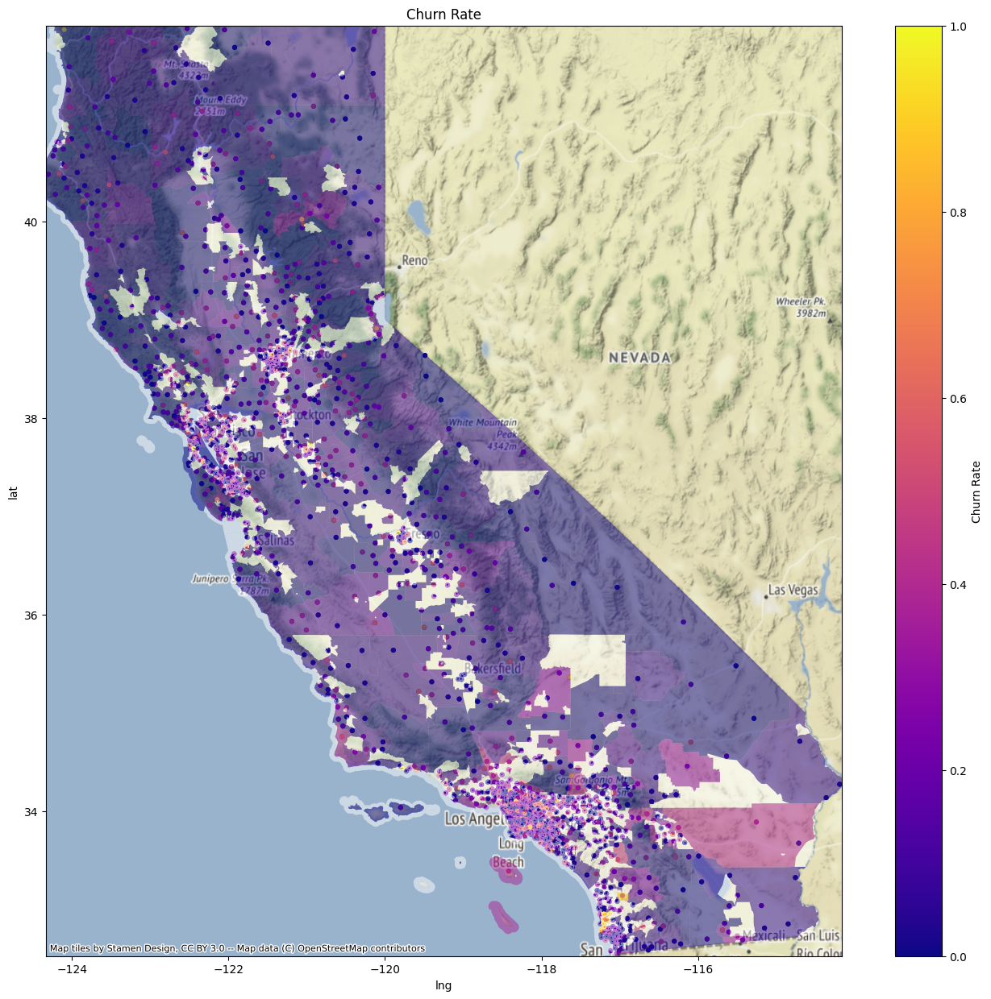

In [28]:
spatial_plot(df_rates, 'Churn Rate', None)

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


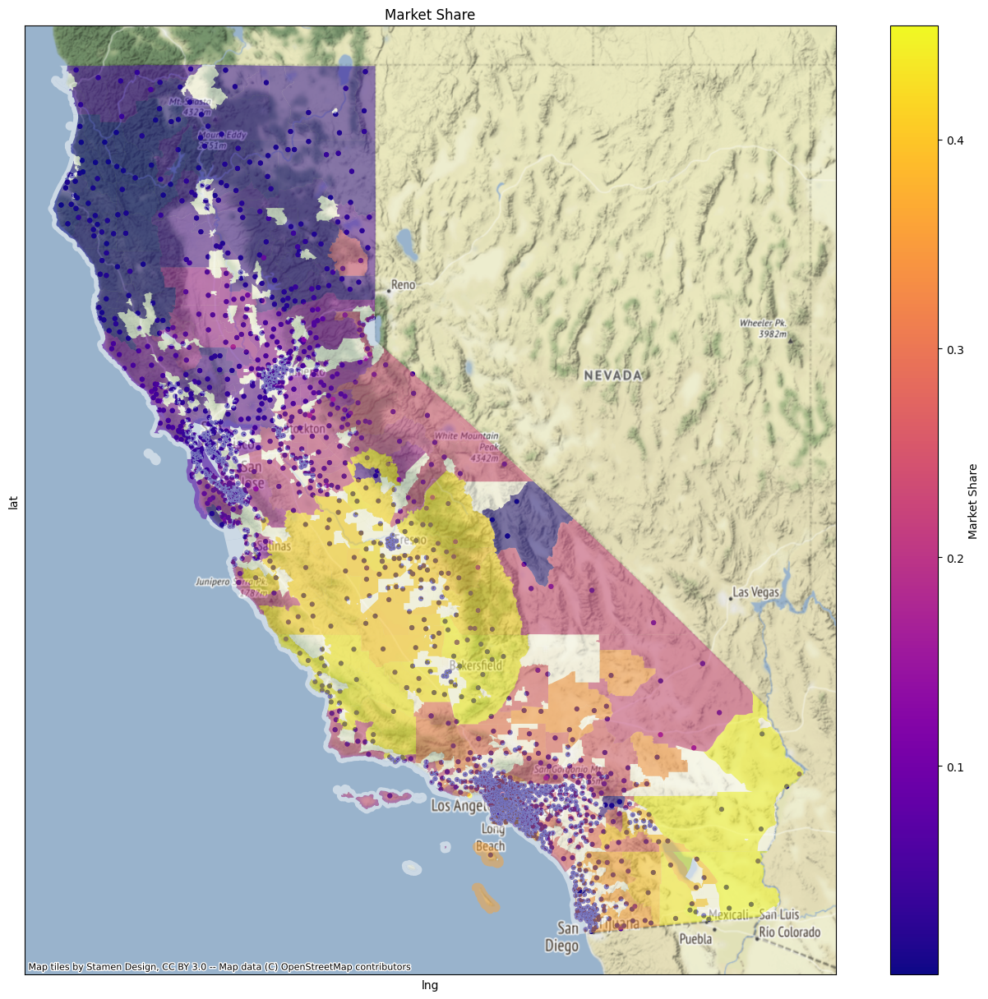

In [32]:
spatial_plot(df_rates, 'Market Share', None)


#### Cities with highest and lowest market share and churn rate:

In [59]:

df_cities_rates = df_rates.pivot_table(index='City', values= ['Churn Rate', 'Market Share'], aggfunc='mean')
top_n = 5
top_max_values_churn = df_cities_rates['Churn Rate'].nlargest(top_n).reset_index()
top_min_values_churn = df_cities_rates['Churn Rate'].nsmallest(top_n).reset_index()
top_max_values_market = df_cities_rates['Market Share'].nlargest(top_n).reset_index()
top_min_values_market = df_cities_rates['Market Share'].nsmallest(top_n).reset_index()



### Cities with Top market shares with the churn rates 
### Cities with the Top churn rates with market share 

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarni

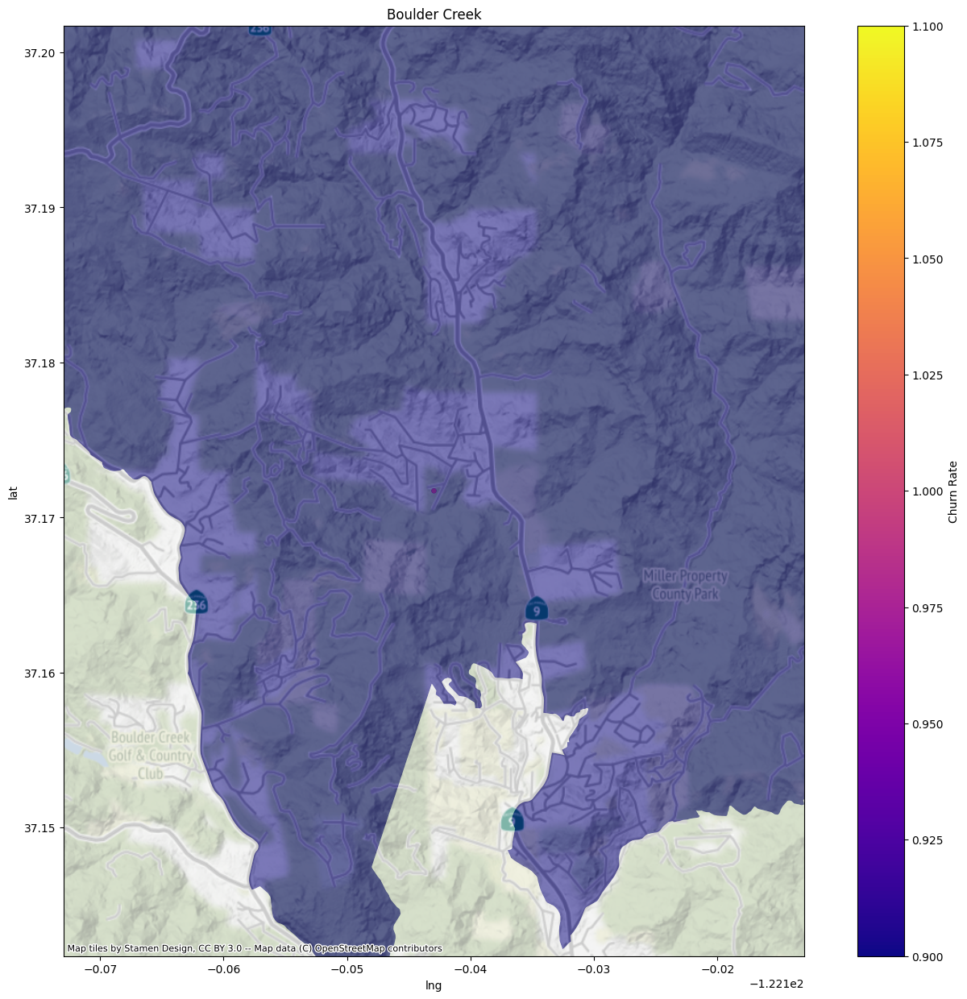

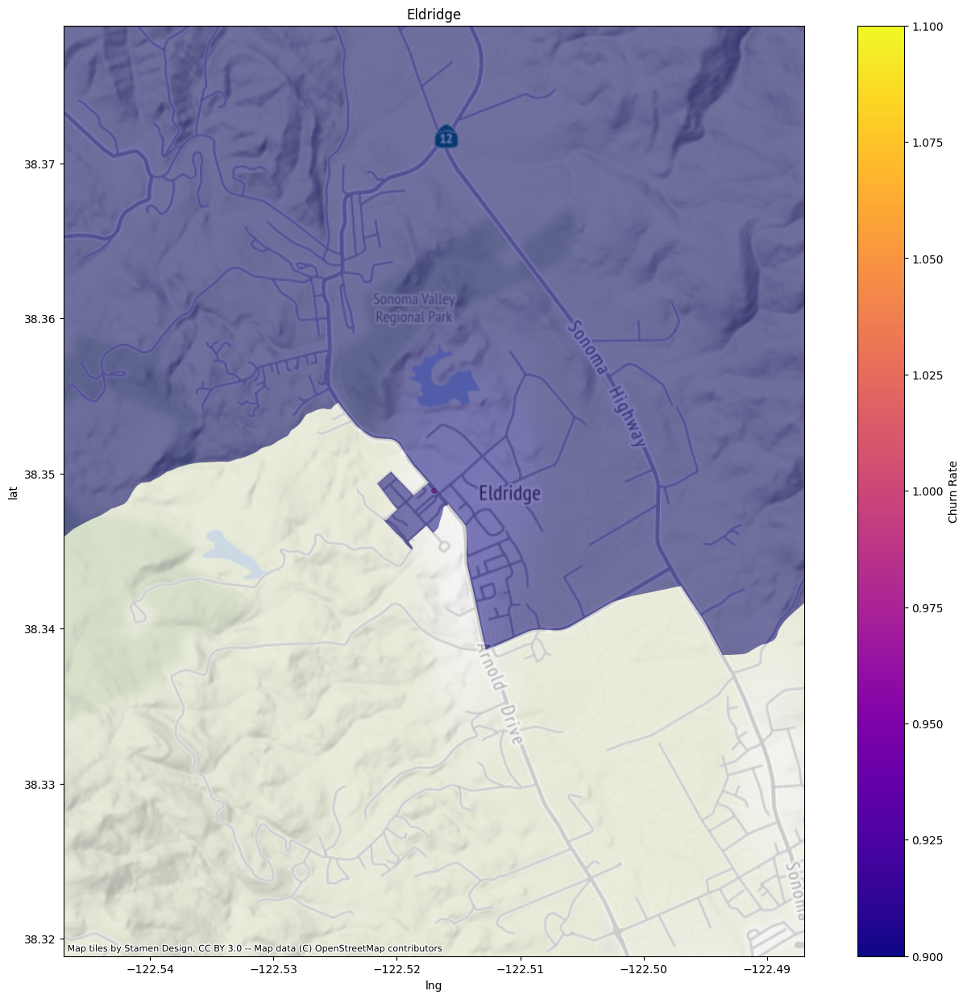

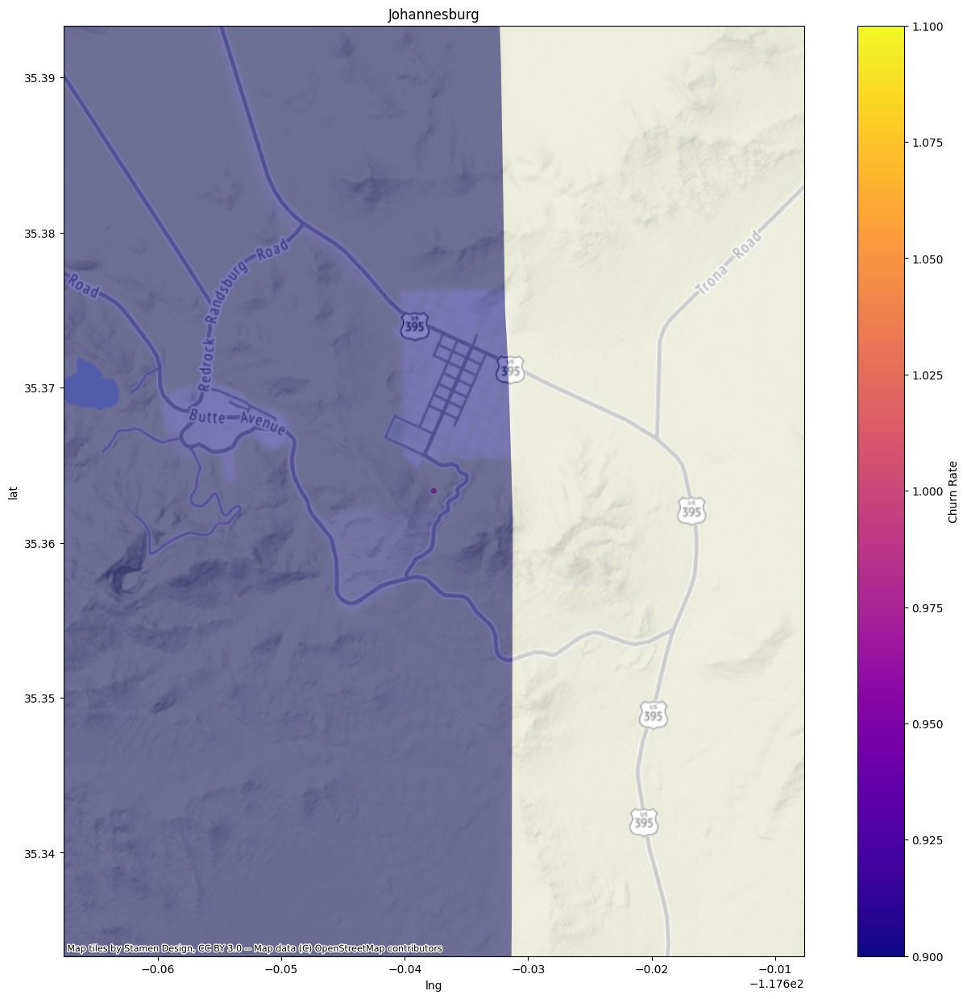

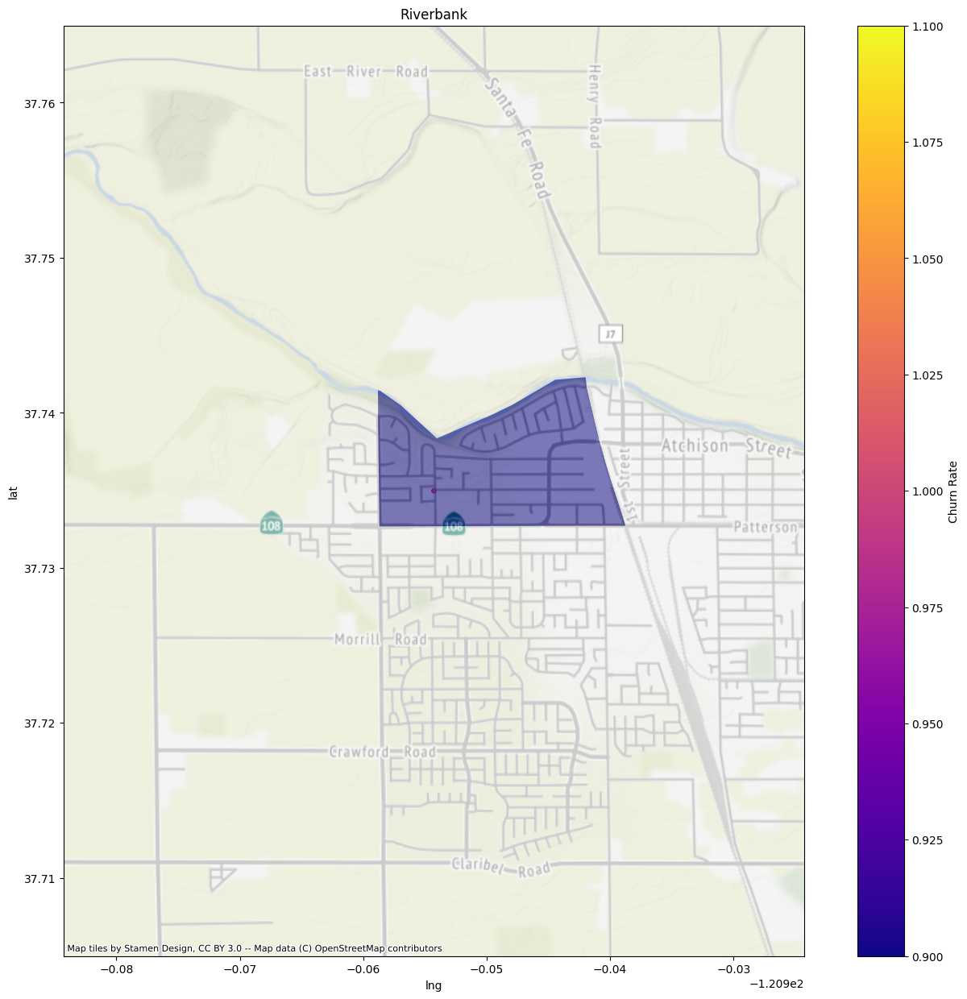

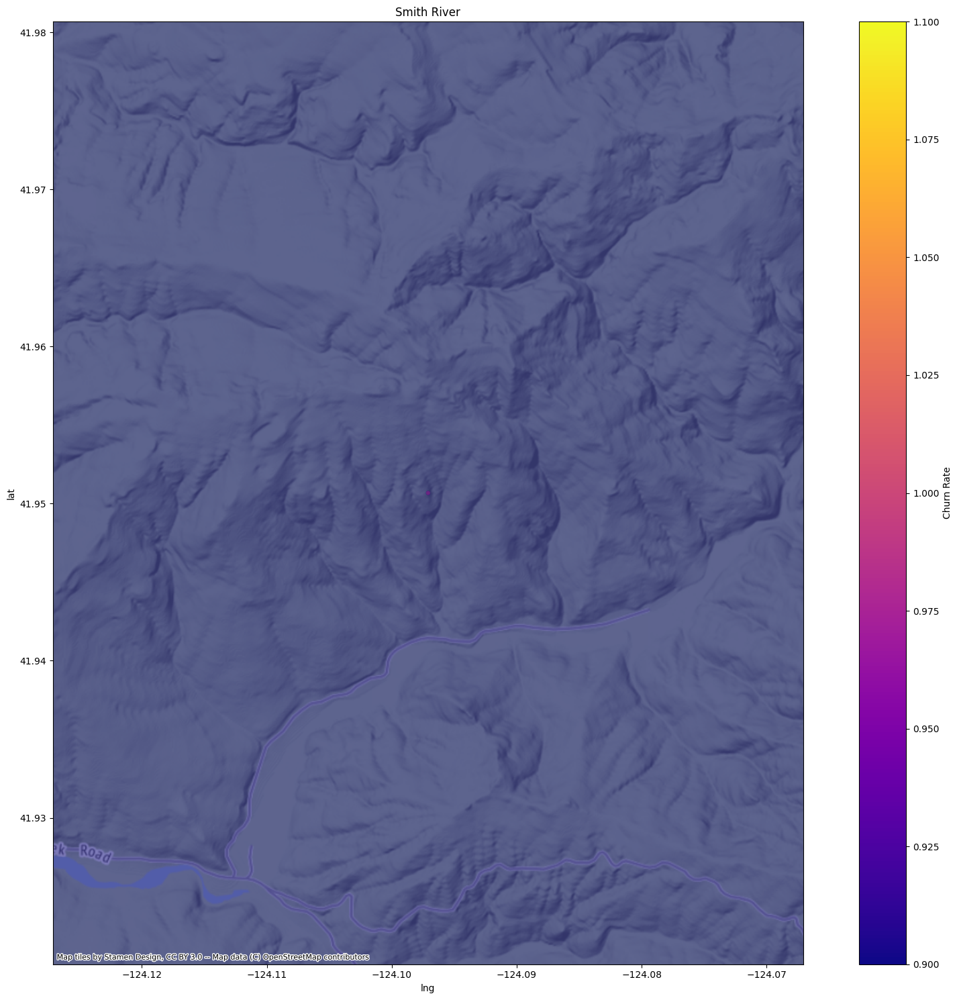

In [248]:
pd.options.mode.chained_assignment = None
cities = top_max_values_churn['City'].tolist()
for city in cities:
    spatial_plot(df_rates, 'Churn Rate', [city], figsize=(17, 15))

plt.tight_layout()
plt.show()

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarni

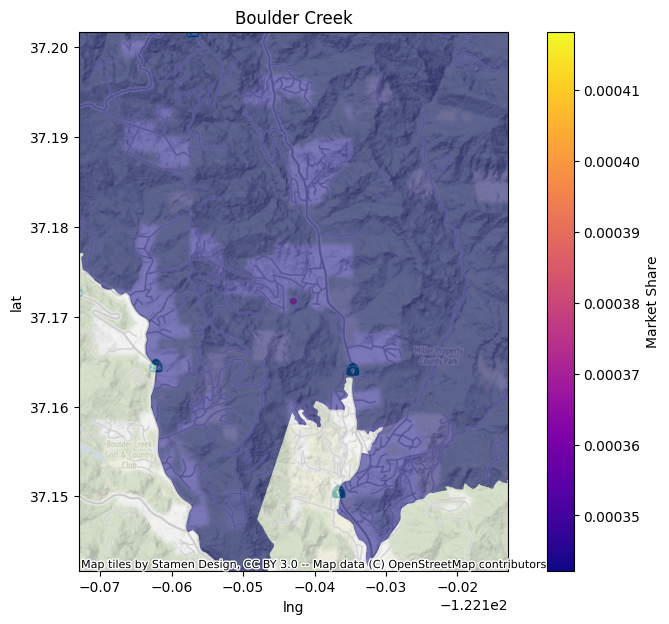

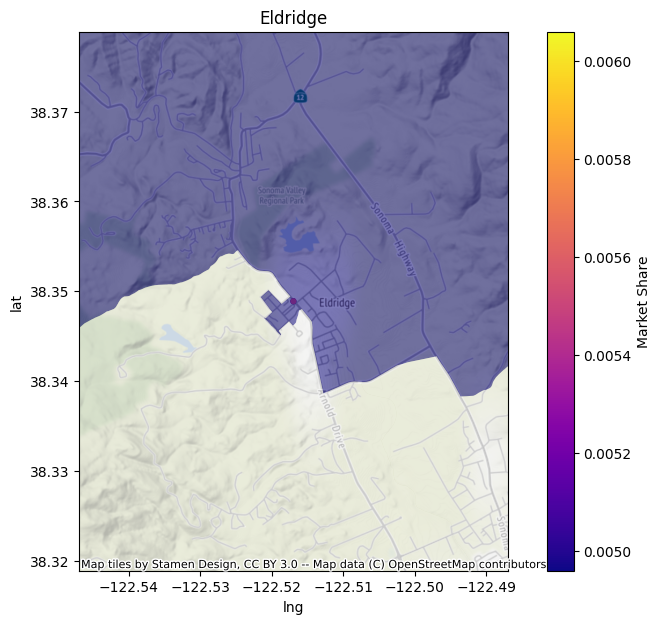

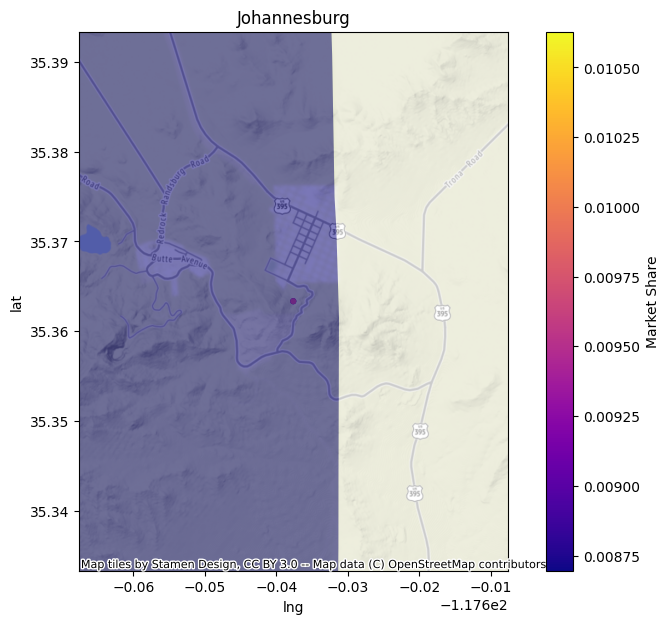

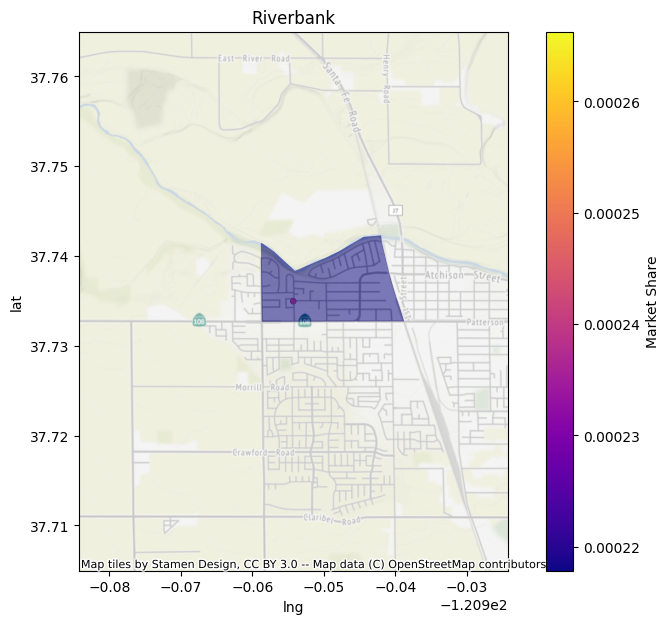

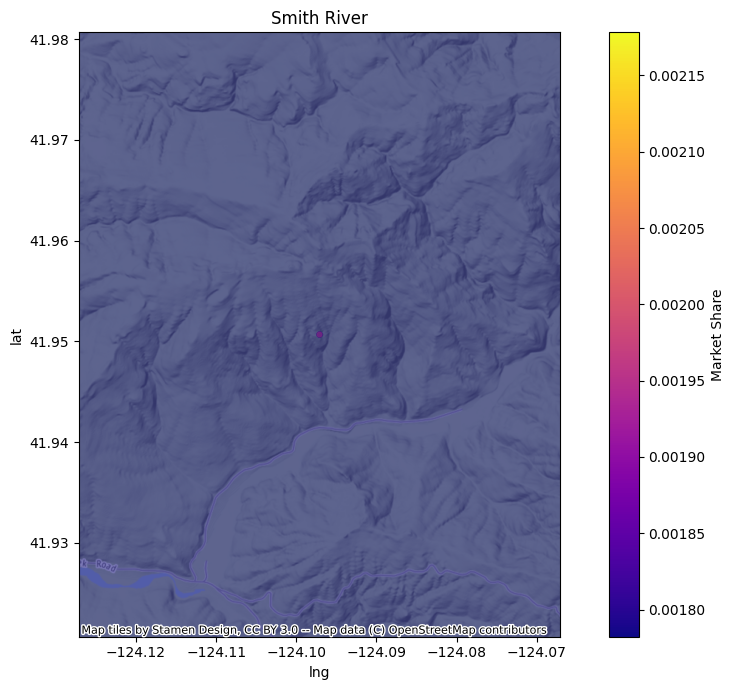

In [262]:
cities = top_max_values_churn['City'].tolist()
for city in cities:
    spatial_plot(df_rates, 'Market Share', [city], figsize=(10, 7))

plt.tight_layout()
plt.show()

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarni

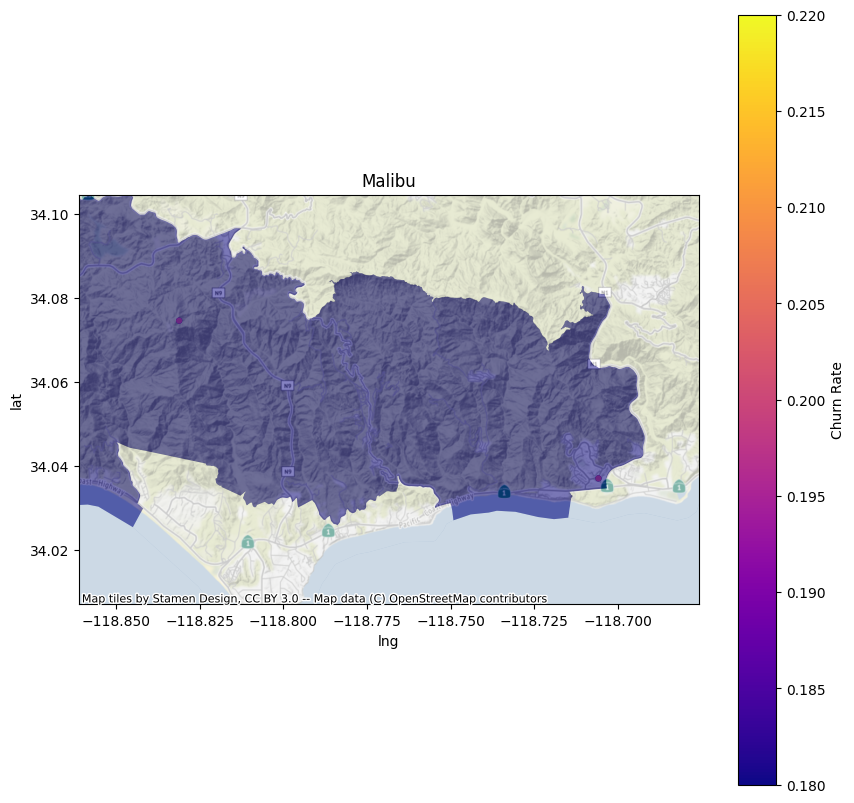

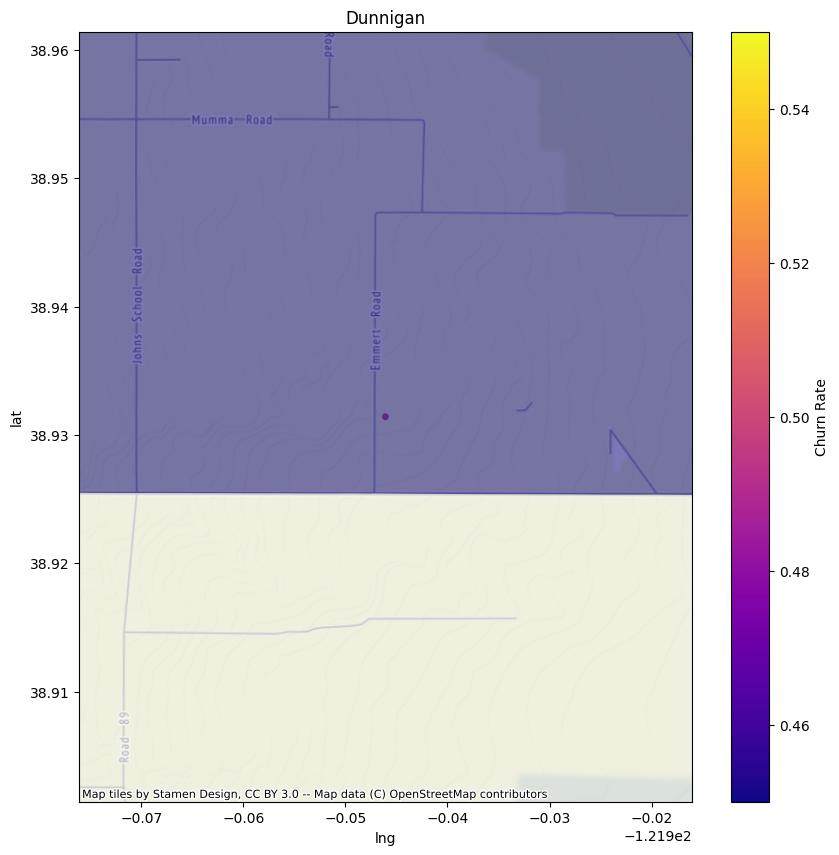

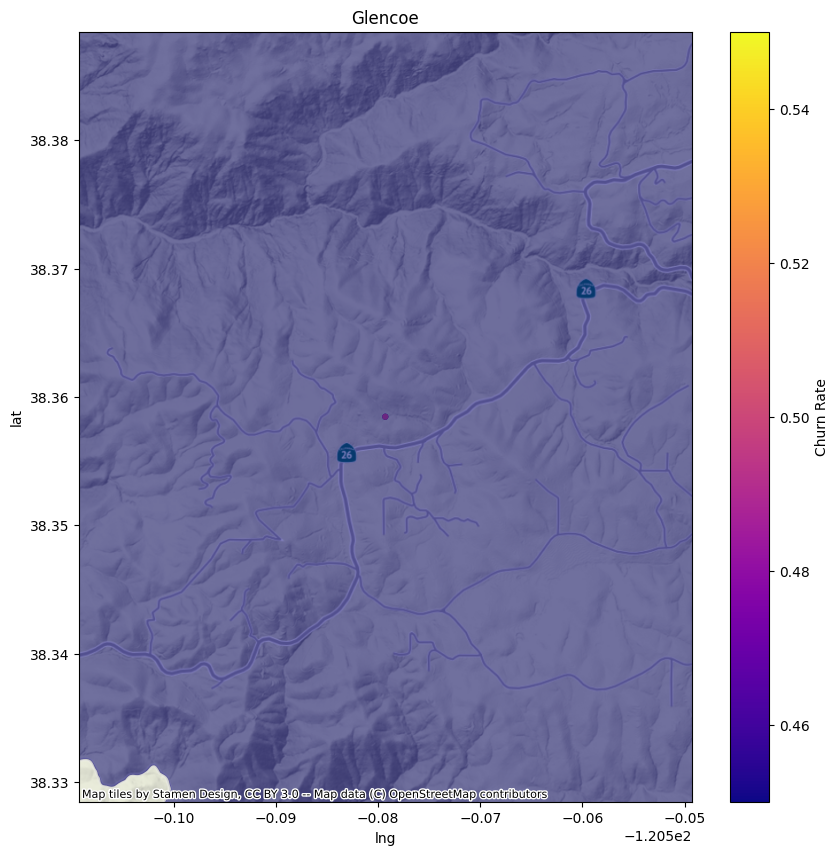

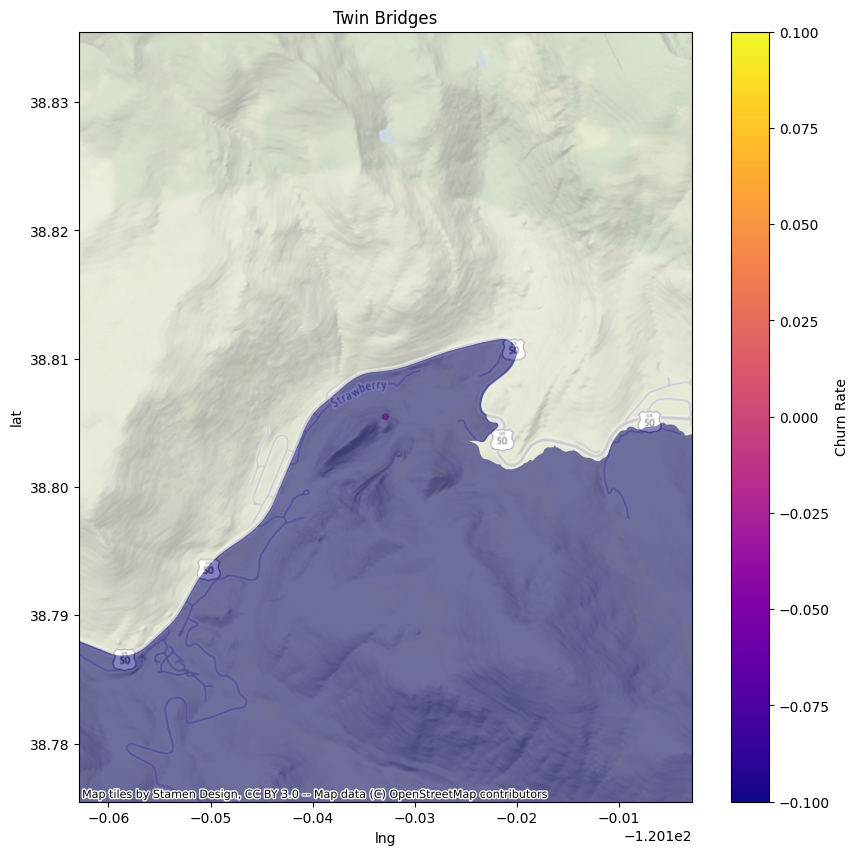

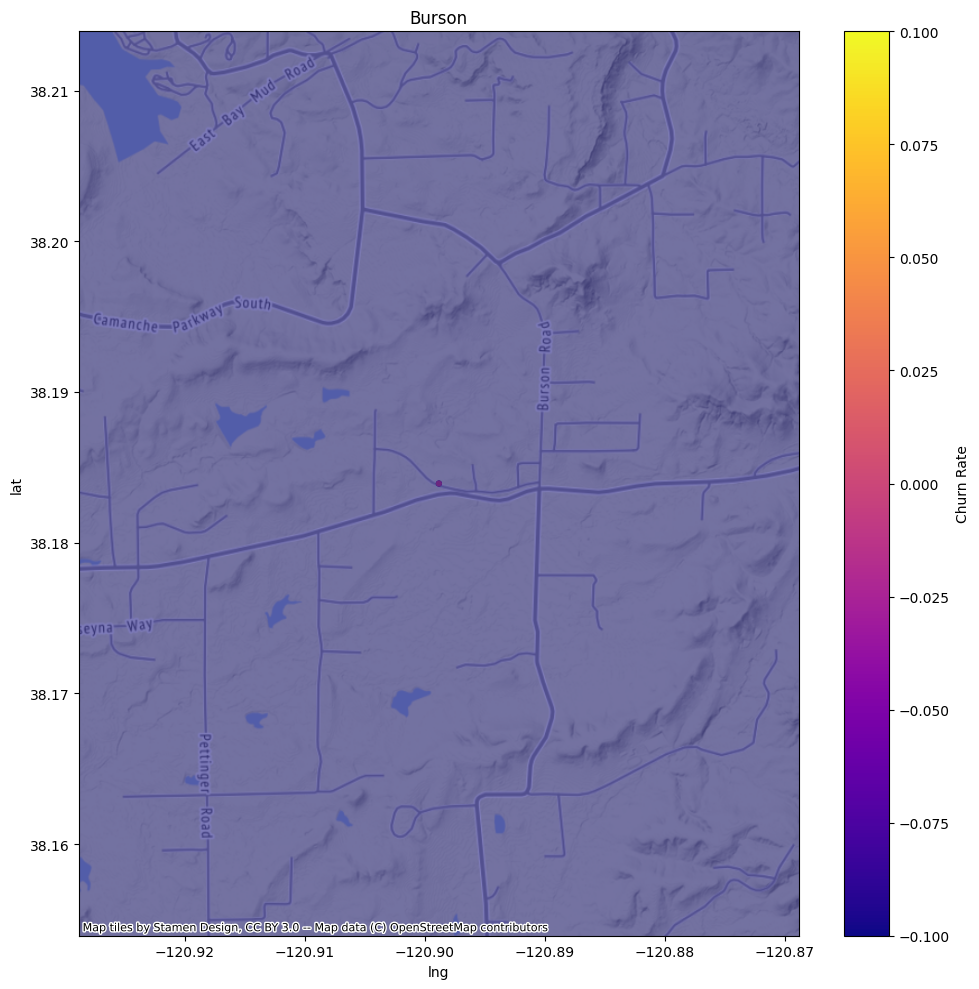

In [263]:
cities = top_max_values_market['City'].tolist()
for city in cities:
    spatial_plot(df_rates, 'Churn Rate', [city], figsize=(10, 10))

plt.tight_layout()
plt.show()

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarni

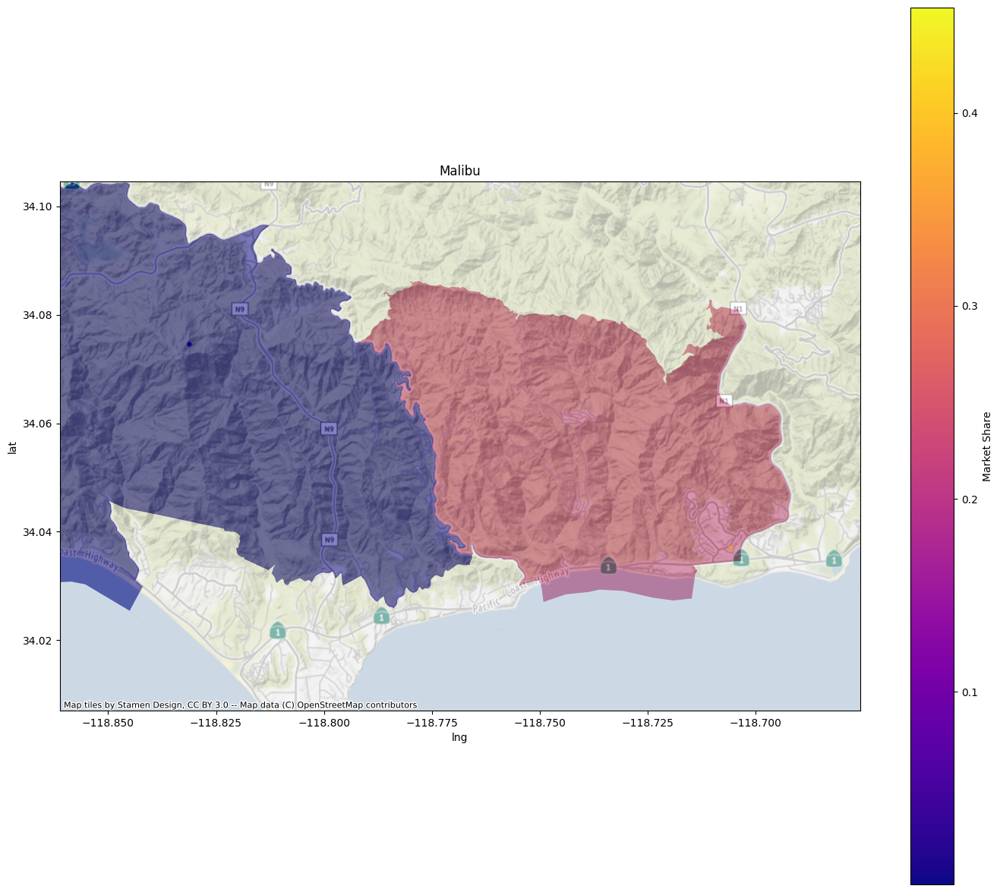

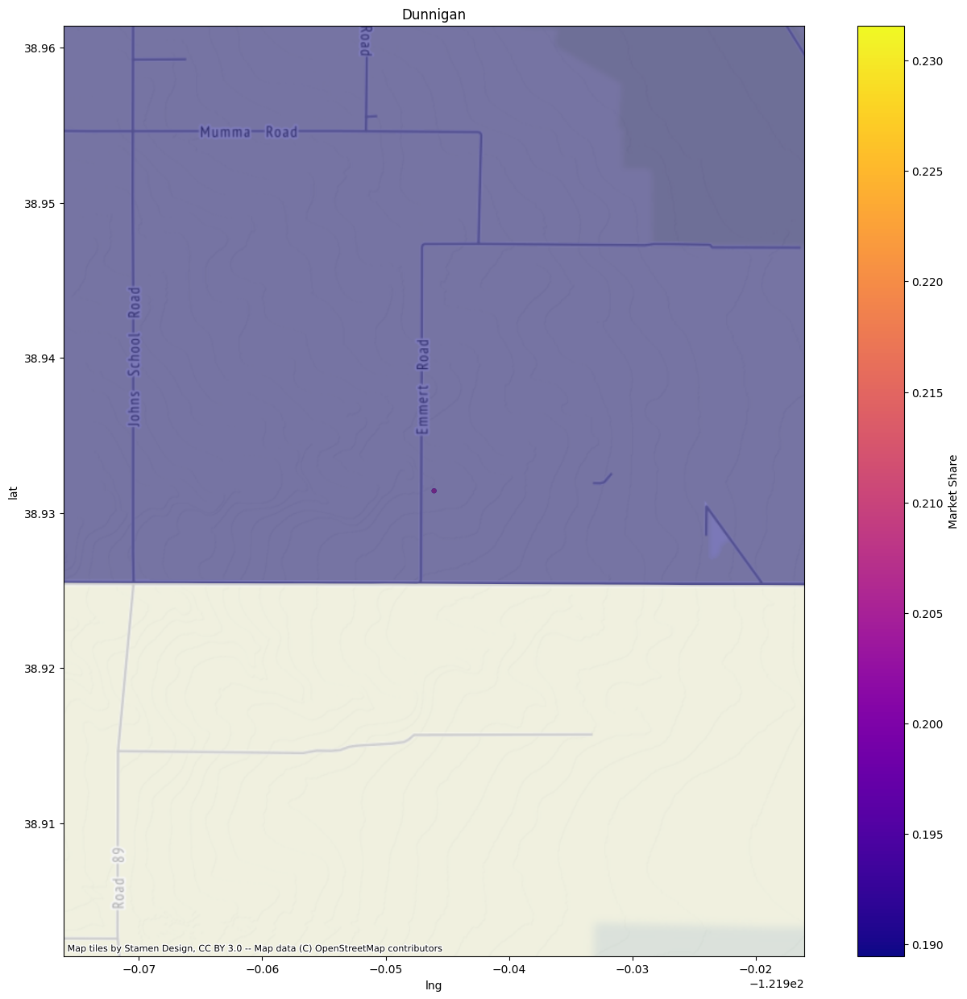

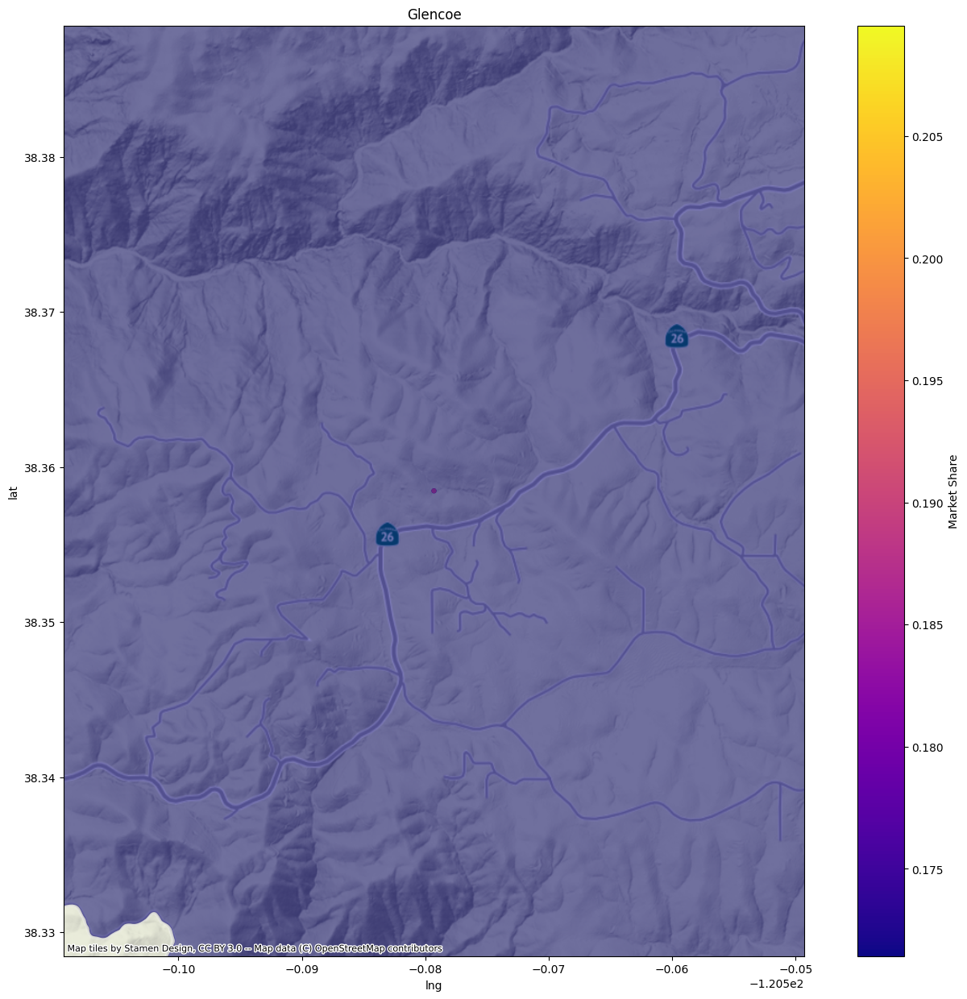

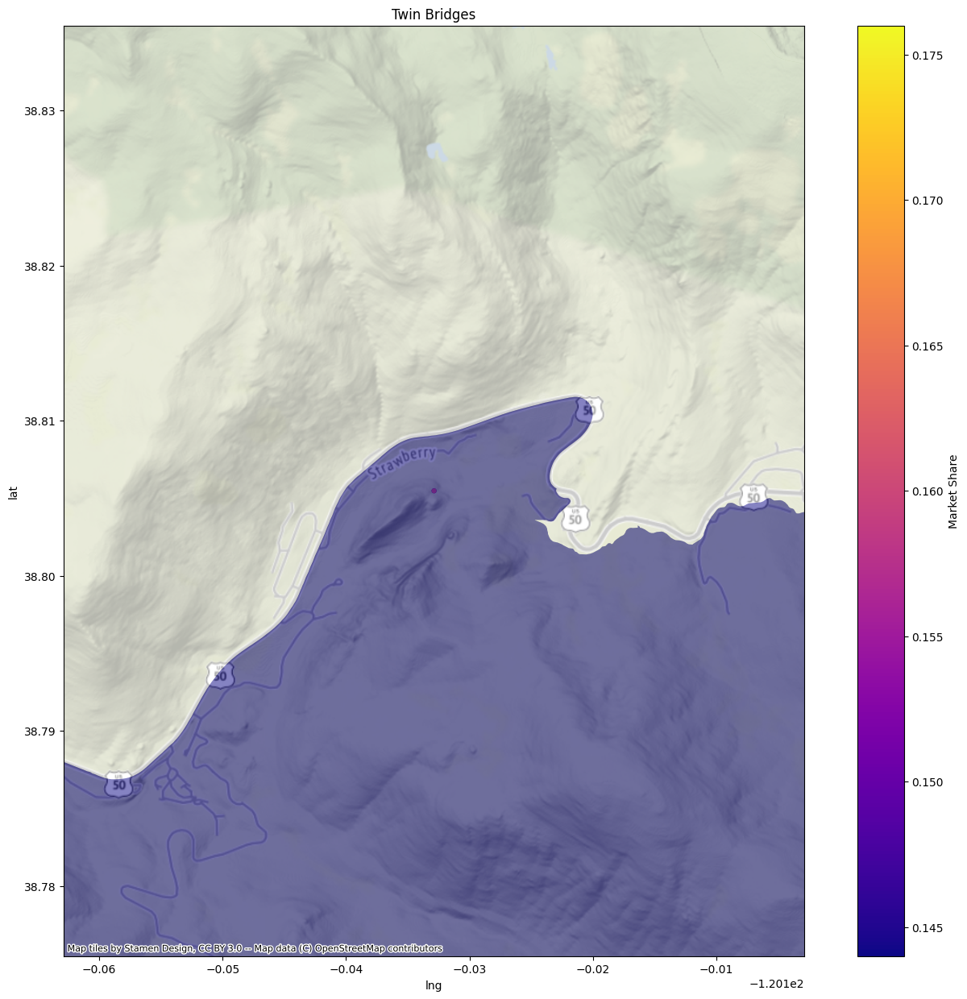

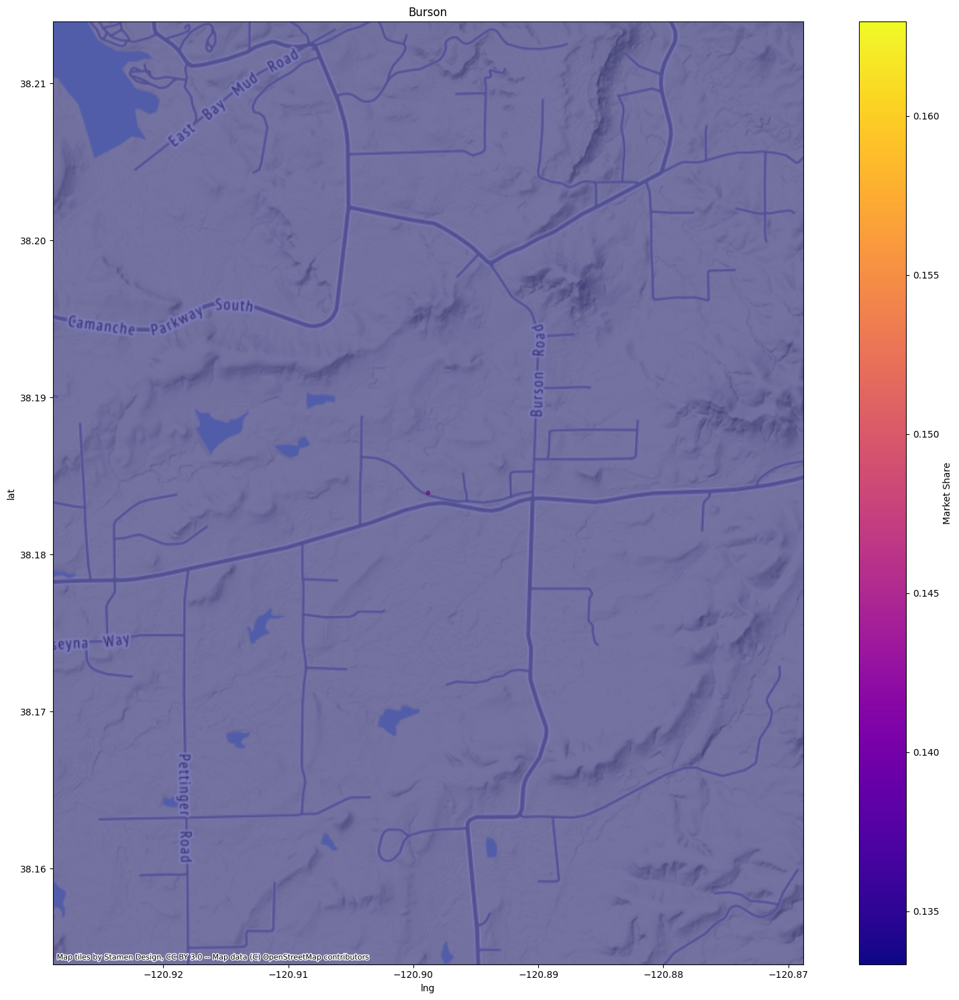

In [251]:
cities = top_max_values_market['City'].tolist()
for city in cities:
    spatial_plot(df_rates, 'Market Share', [city], figsize=(17, 15))

plt.tight_layout()
plt.show()

### Cities with the highest Variance over market share and churn rate

In [67]:
df_cities_vars = df_rates.pivot_table(index='City', values= ['Churn Rate', 'Market Share'], aggfunc='var')
top_max_vars_market = df_cities_vars['Market Share'].nlargest(top_n).reset_index()
top_max_vars_churn = df_cities_vars['Churn Rate'].nlargest(top_n).reset_index()

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarni

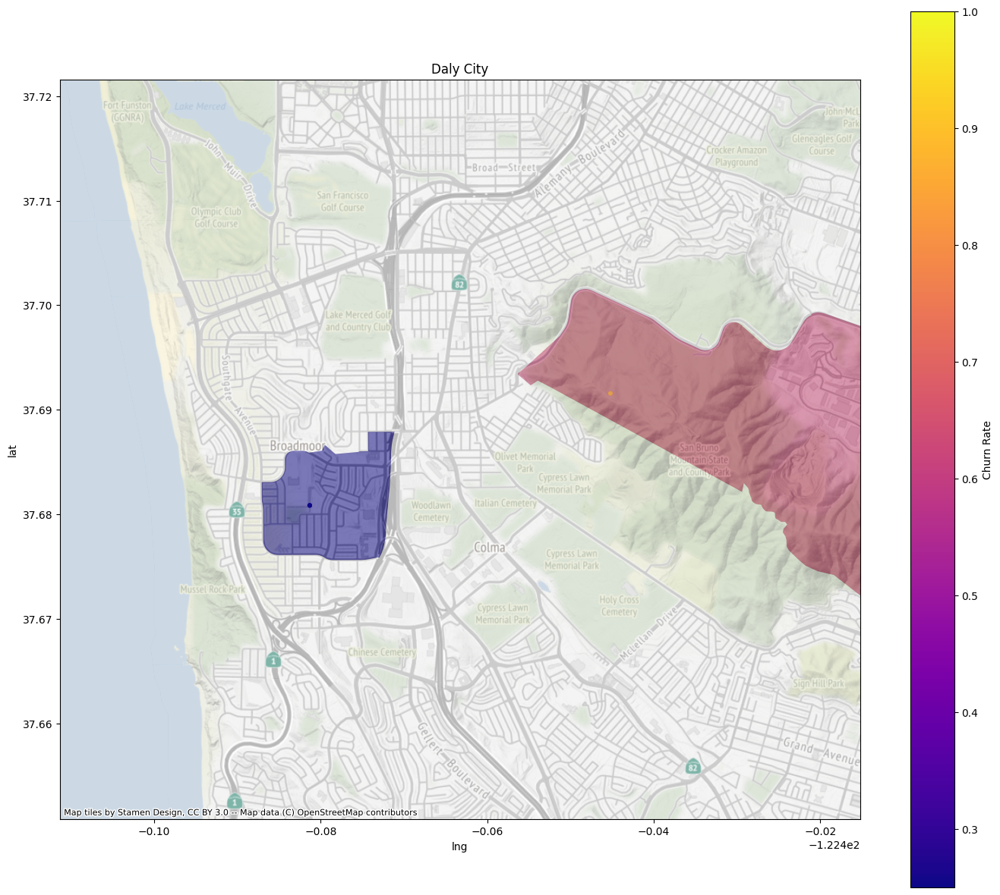

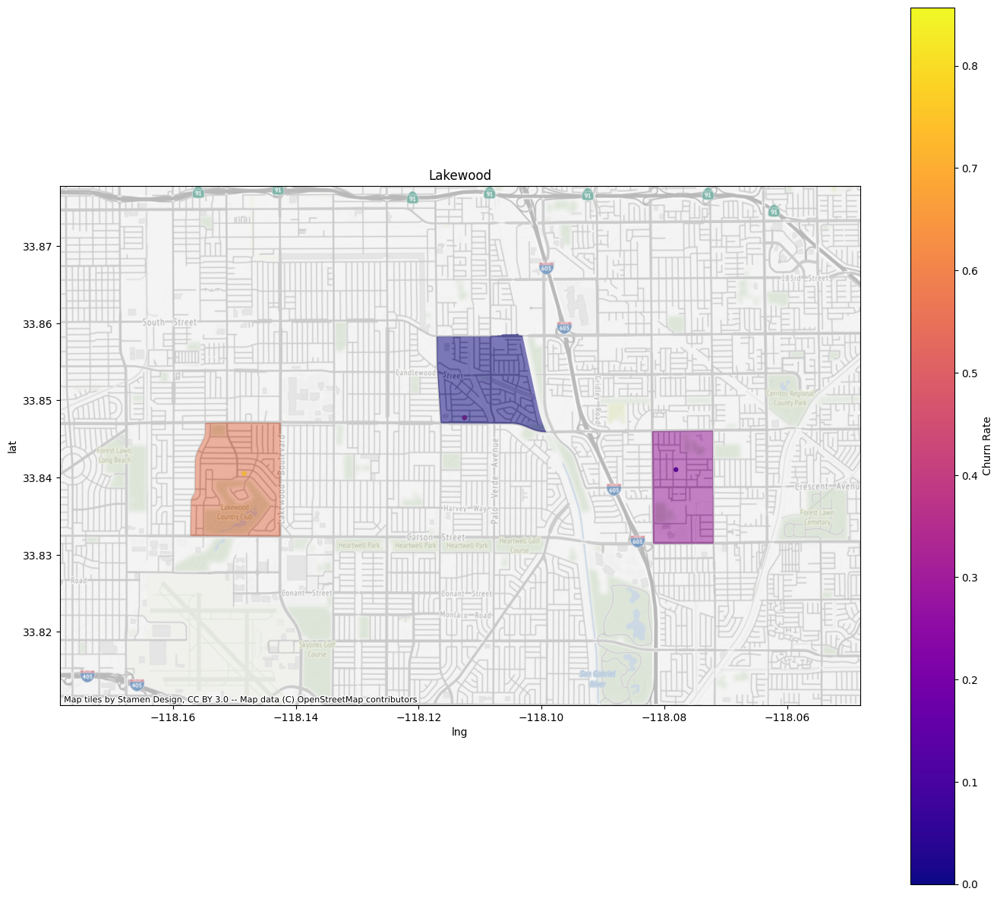

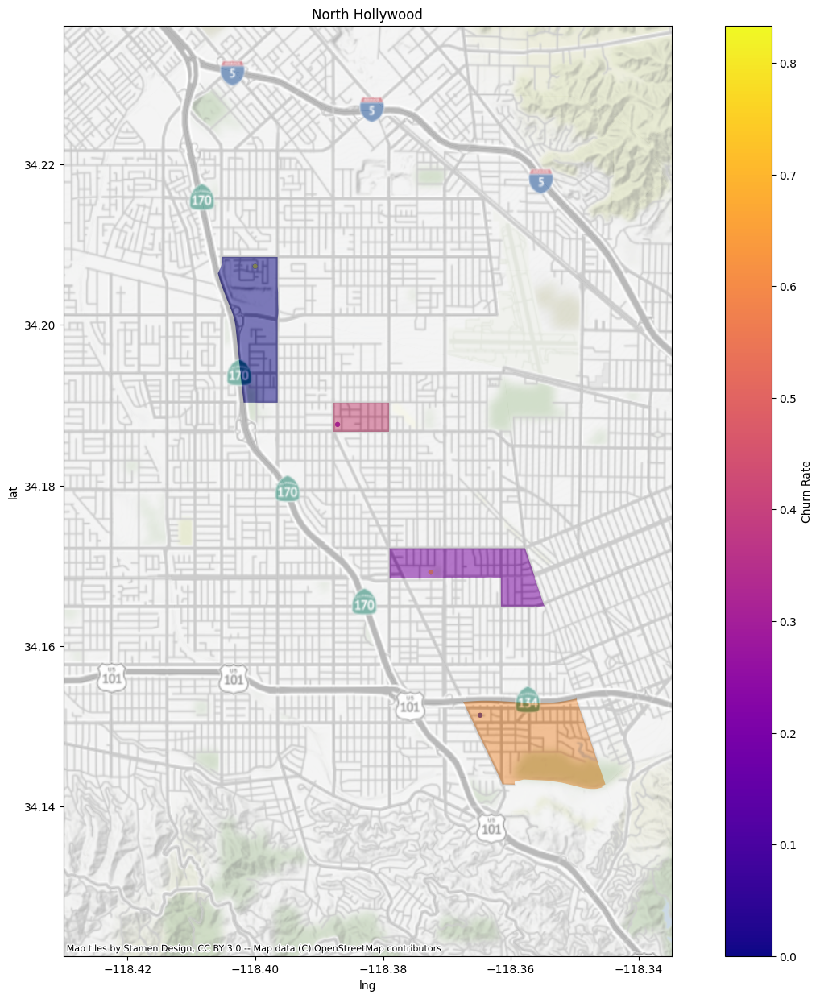

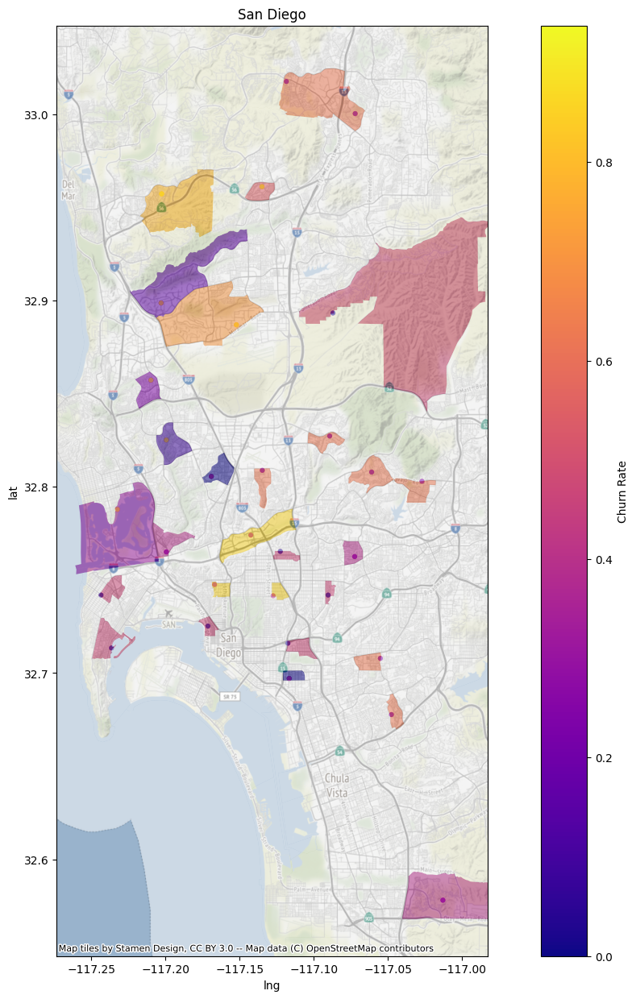

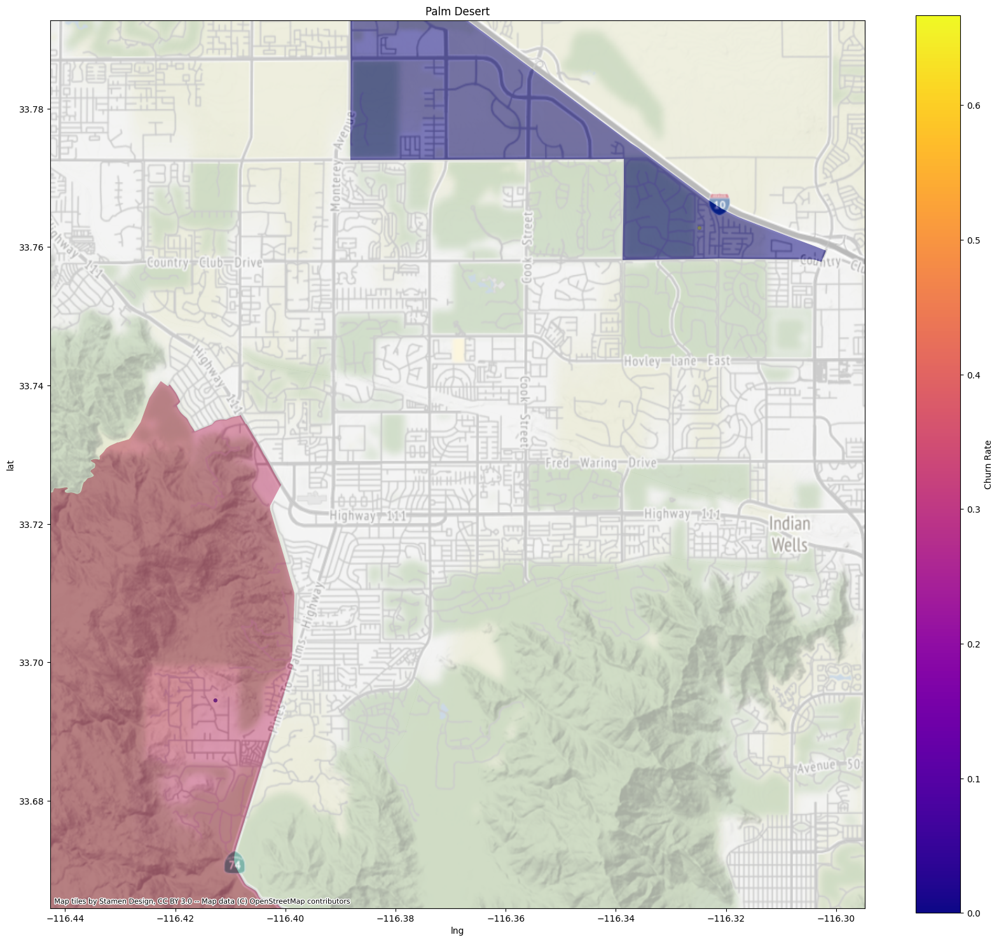

In [252]:
cities  = top_max_vars_churn['City'].tolist()
for city in cities:
    spatial_plot(df_rates, 'Churn Rate', [city], figsize=(17, 15))

plt.tight_layout()
plt.show()

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarni

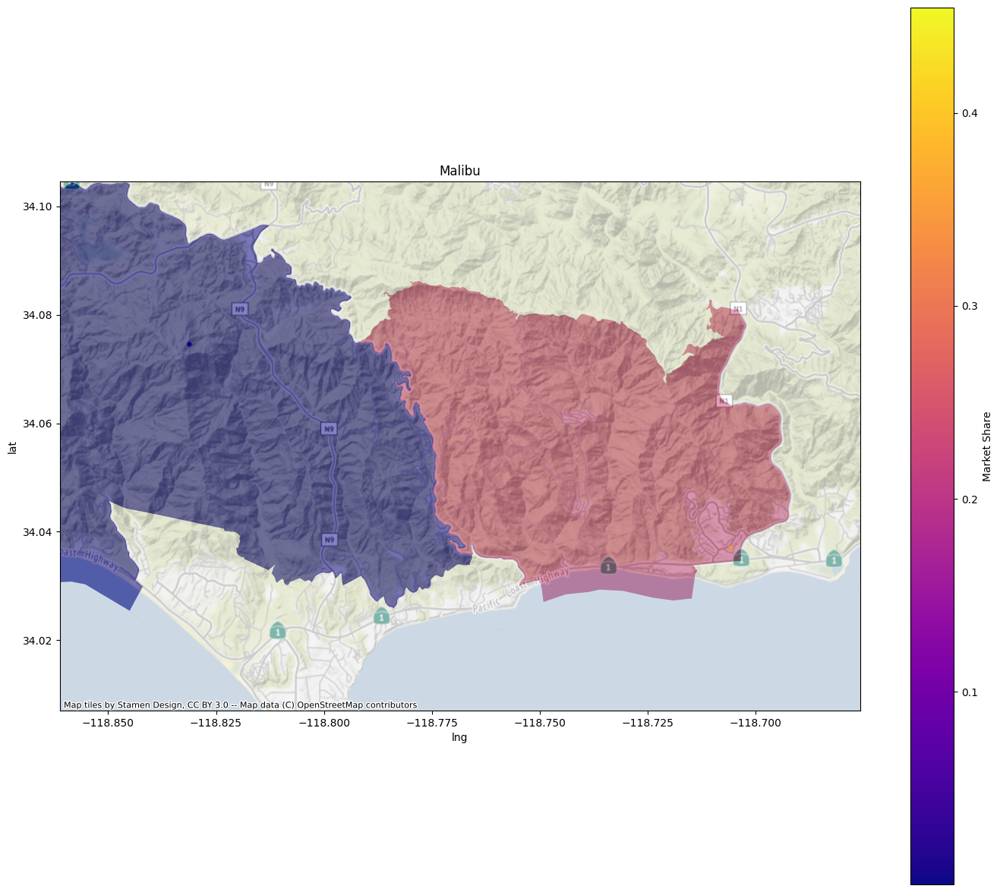

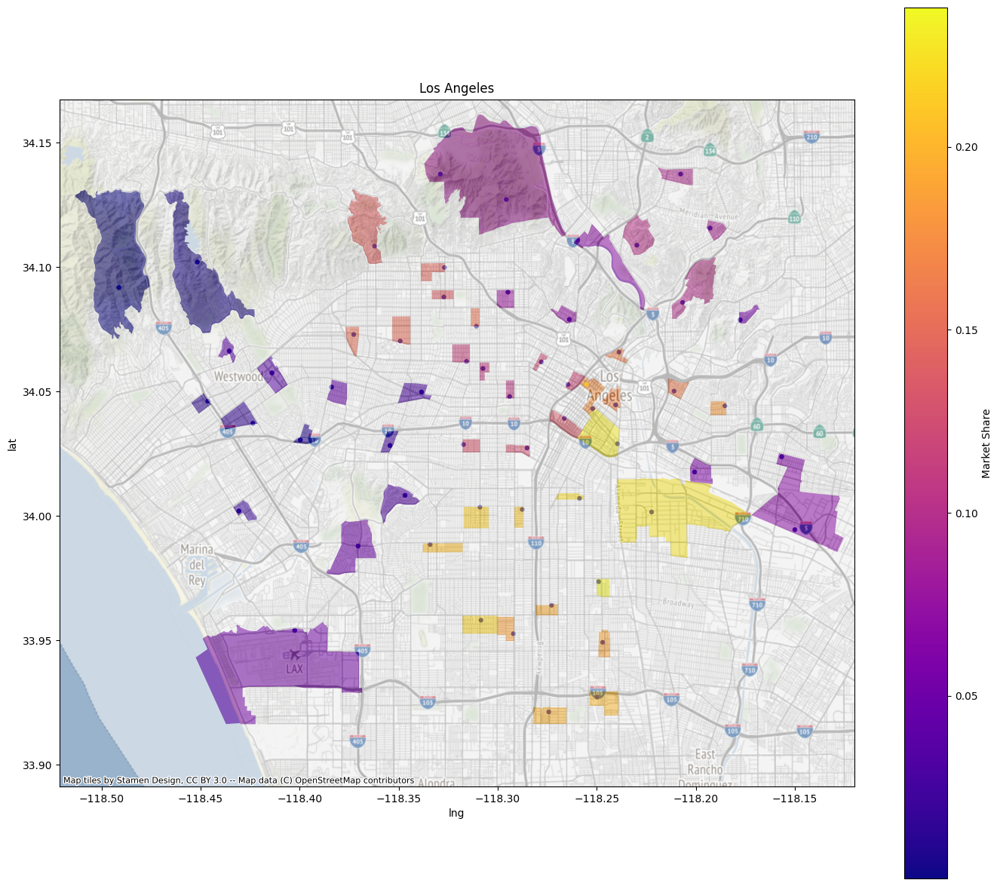

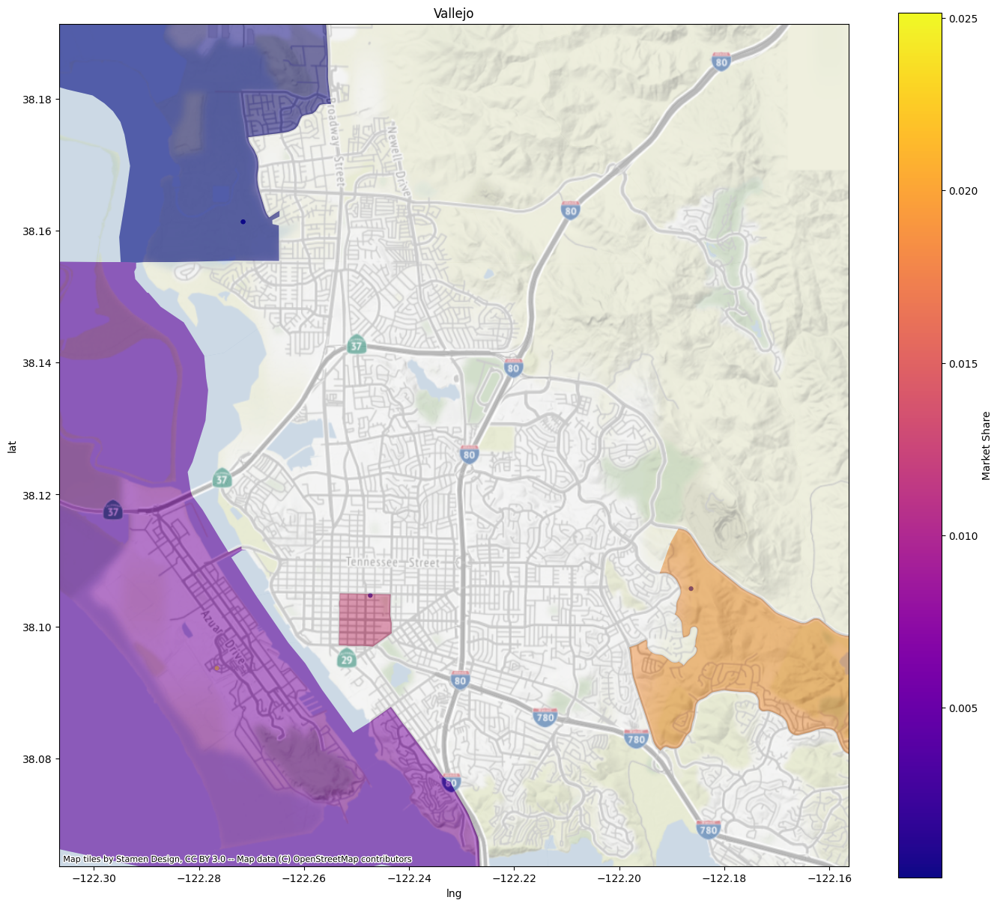

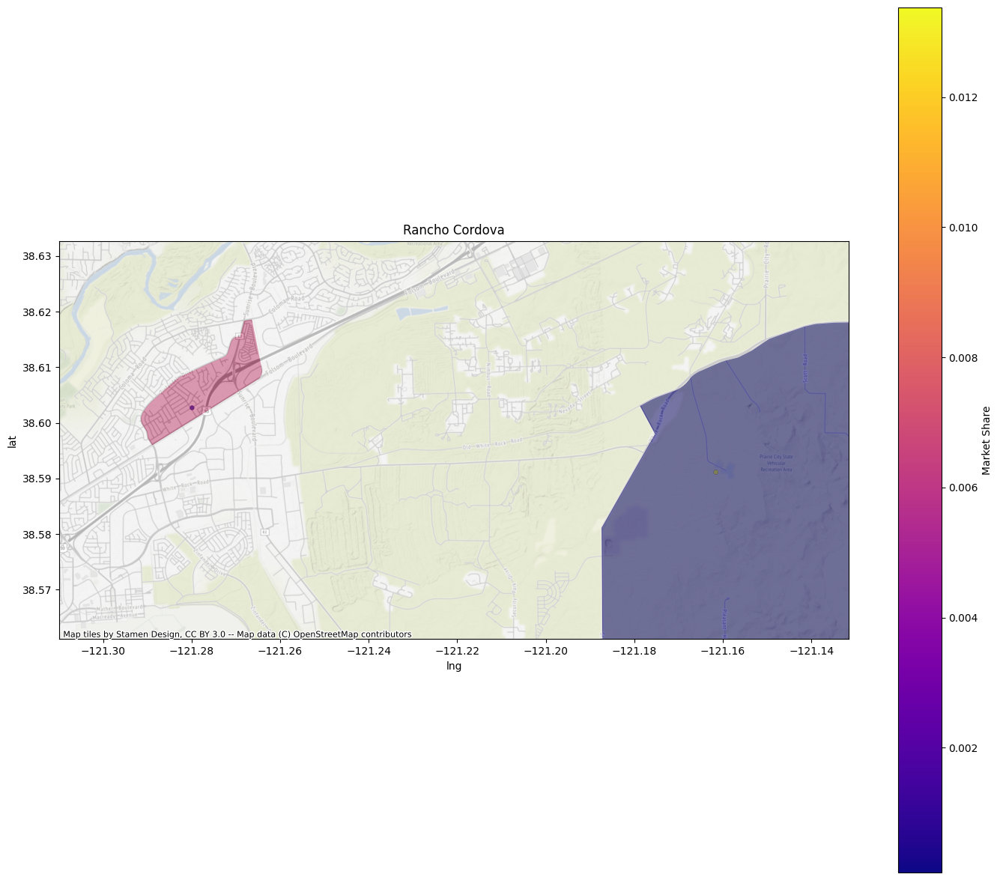

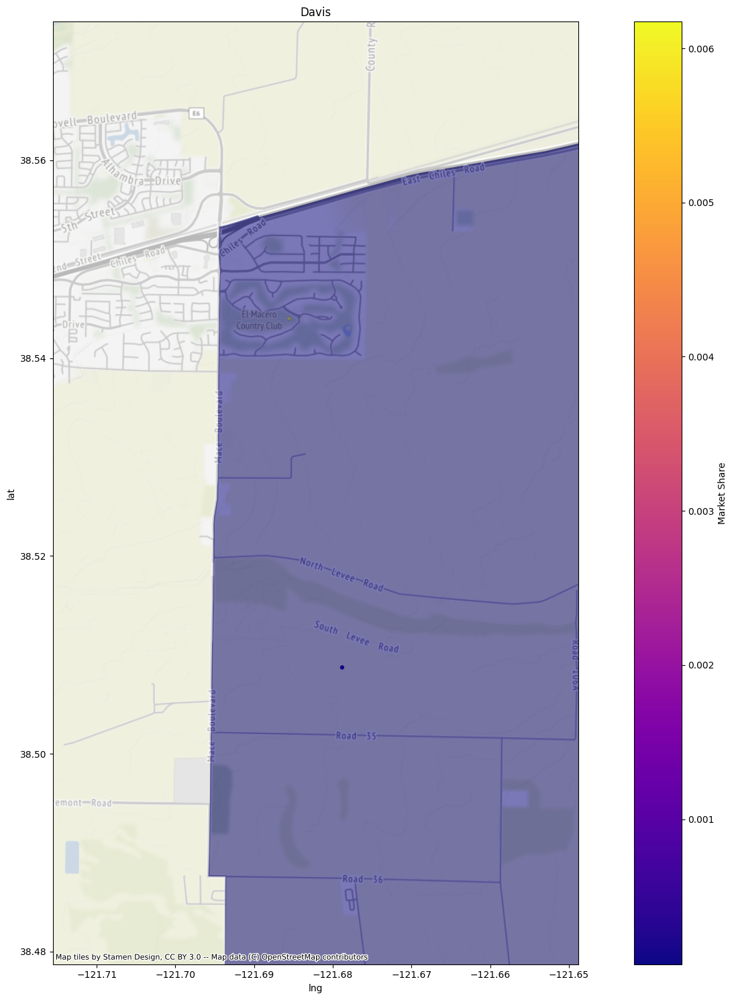

In [253]:
cities = top_max_vars_market['City'].tolist()

for city in cities:
    spatial_plot(df_rates, 'Market Share', [city], figsize=(17, 15))

plt.tight_layout()
plt.show()

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(
/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


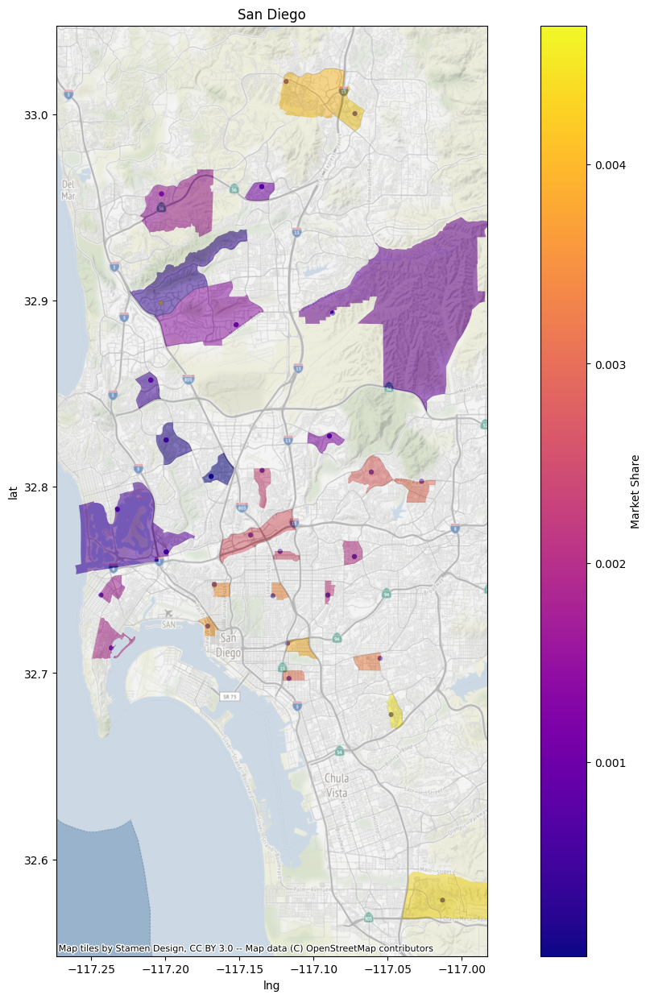

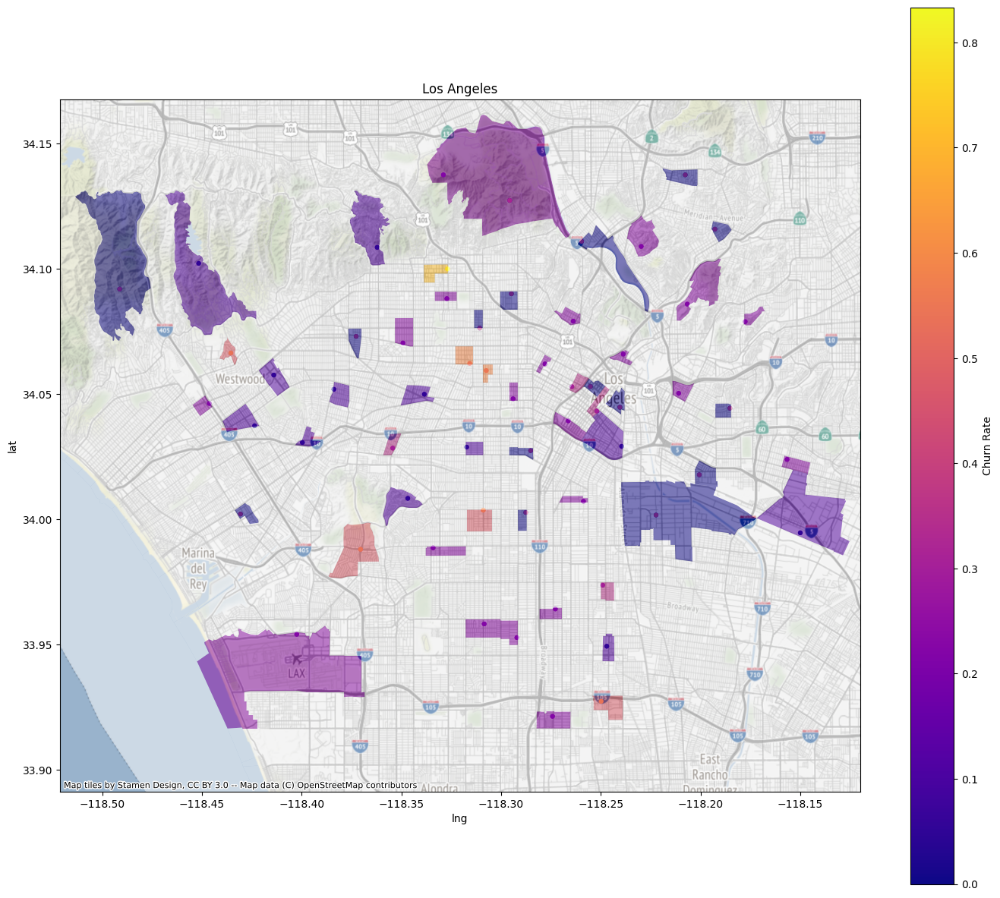

In [254]:
spatial_plot(df_rates, 'Market Share', ['San Diego'], figsize=(17, 15))
spatial_plot(df_rates, 'Churn Rate', ['Los Angeles'], figsize=(17, 15))

### Churn values distribution over different params on top cities values

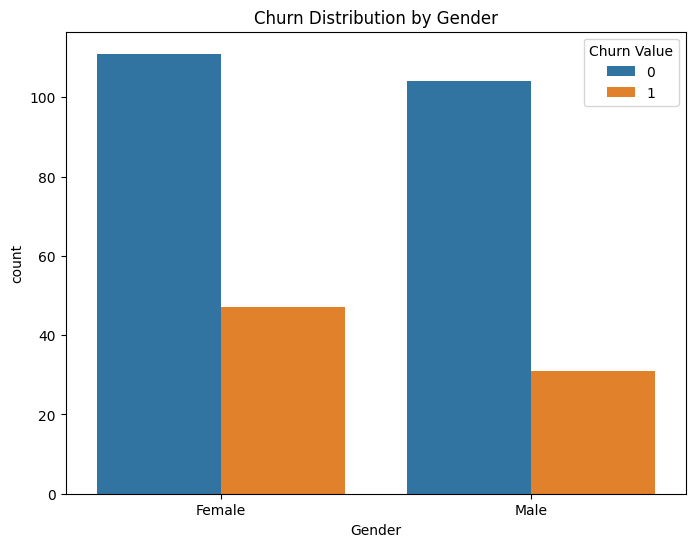

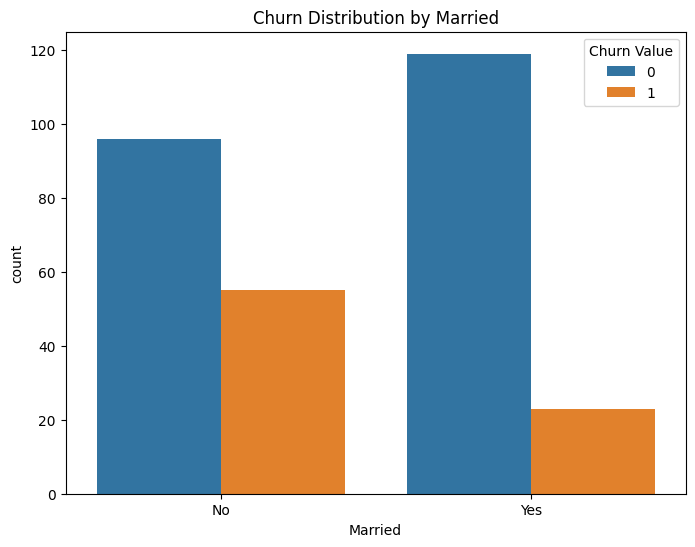

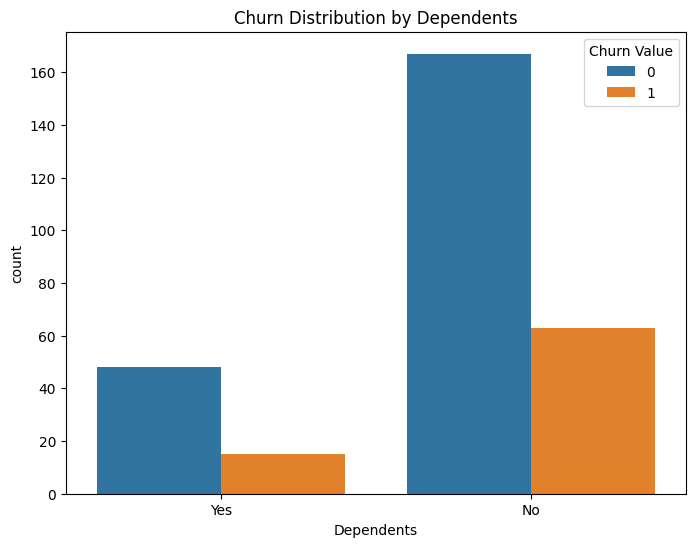

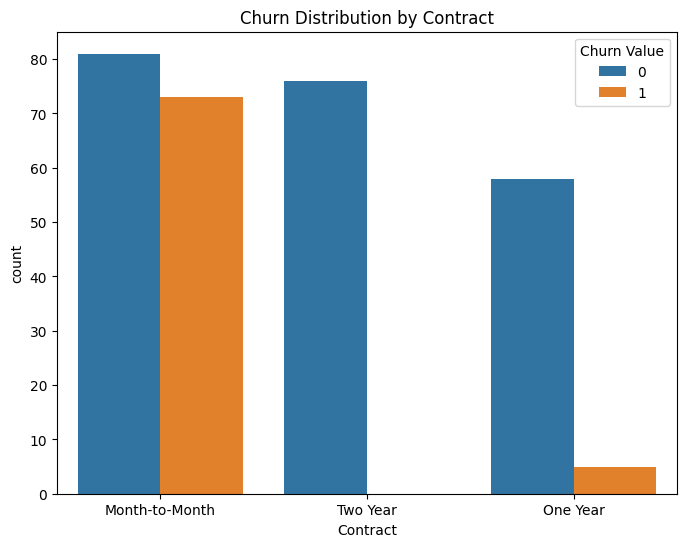

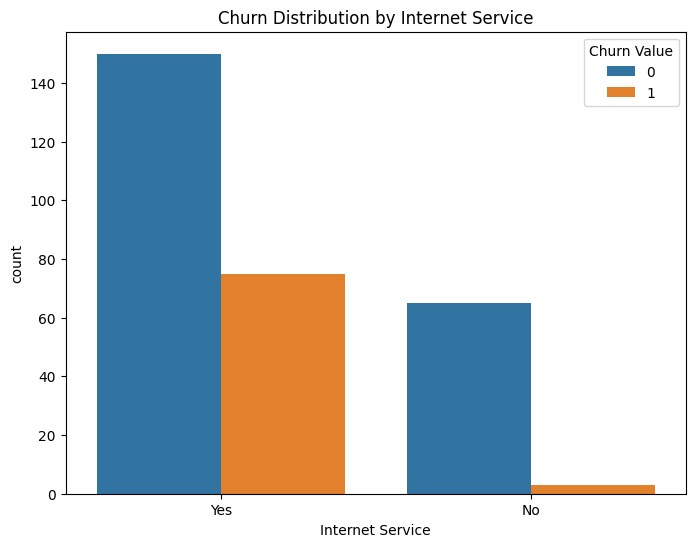

...

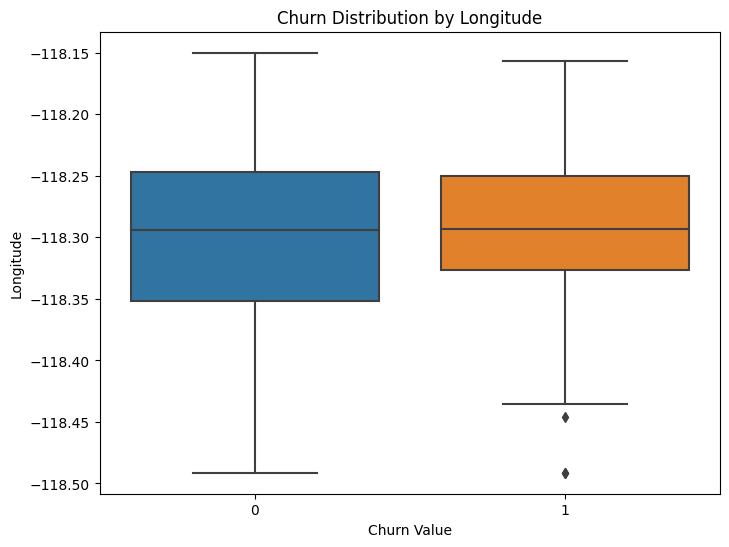

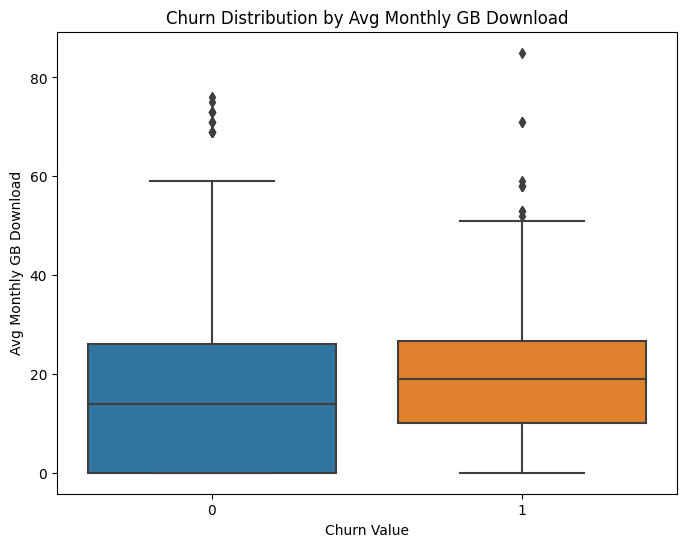

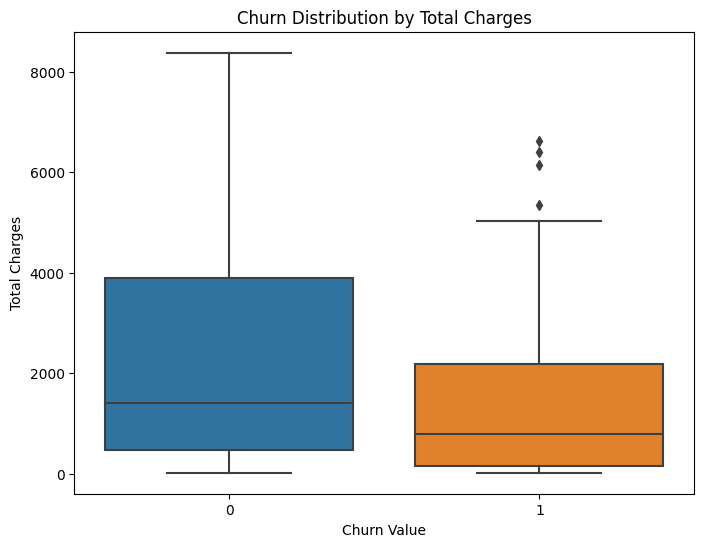

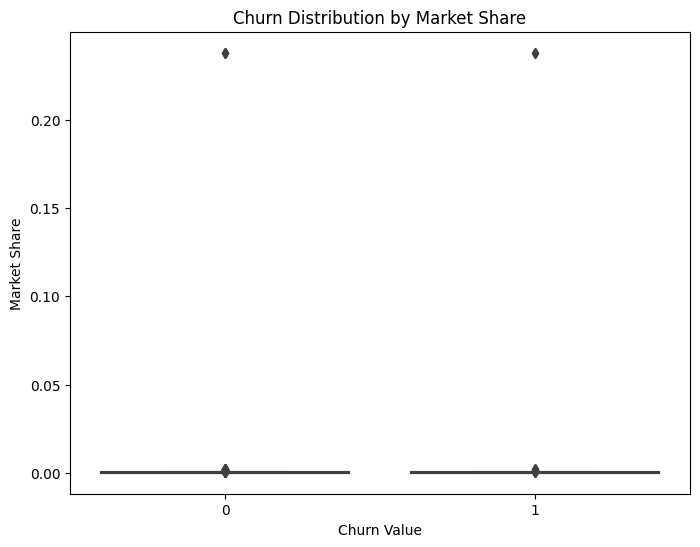

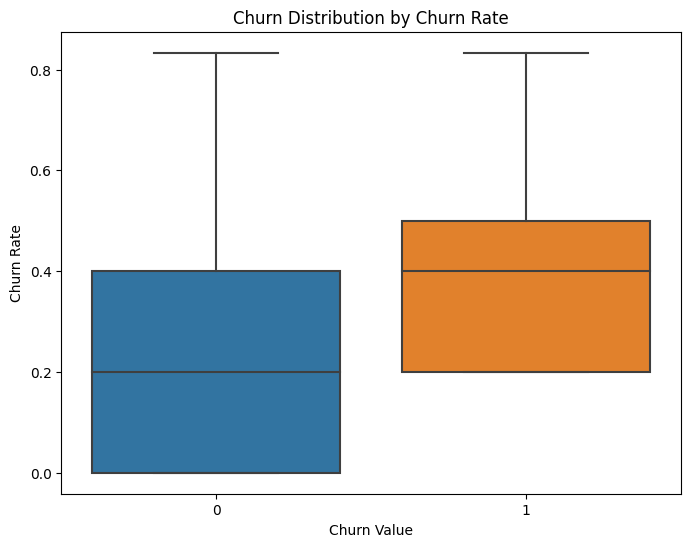

In [30]:
import seaborn as sns

high_var_cities = df_rates[df_rates.City.isin(['San Diago', 'Los Angeles'])]
high_var_cities

categorical_columns = ['Gender', 'Married', 'Dependents', 'Contract', 'Internet Service', 'Offer', 'Referred a Friend', 
'Home Phone Service', 'Internet Type', 'Internet Service', 'Device Protection Plan', 'Contract', 'Unlimited Data']
for column in categorical_columns:
    plt.figure(figsize=(8, 6))
    sns.countplot(x=column, hue='Churn Value', data=high_var_cities)
    plt.title(f'Churn Distribution by {column}')
    plt.show()

# Visualize churn distribution based on numerical features
numerical_columns = ['Age', 'Tenure in Months', 'Monthly Charge', 'Latitude', 'Longitude', 'Avg Monthly GB Download', 'Total Charges', 'Market Share', 'Churn Rate']
for column in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x='Churn Value', y=column, data=high_var_cities)
    plt.title(f'Churn Distribution by {column}')
    plt.show()

In [31]:
df_rates

,Customer ID,State,City,Zip Code,Latitude,Longitude,Gender,Age,Married,Dependents,...,Total Revenue,Satisfaction Score,Customer Status,Churn Value,Churn Category,Churn Reason,Population,Customer Count,Market Share,Churn Rate
0,4299-OPXEJ,California,Inglewood,90301,33.956445,-118.358634,Female,57,No,No,...,1858.39,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
1,3733-ZEECP,California,Inglewood,90301,33.956445,-118.358634,Male,29,Yes,Yes,...,1846.92,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
2,0278-YXOOG,California,Inglewood,90301,33.956445,-118.358634,Male,30,No,No,...,285.15,3,Churned,1,Attitude,Attitude of support person,37527.0,5,0.000133,0.2
3,4828-FAZPK,California,Inglewood,90301,33.956445,-118.358634,Female,30,Yes,Yes,...,2065.55,4,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
4,1320-REHCS,California,Inglewood,90301,33.956445,-118.358634,Male,75,No,No,...,7023.82,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1363-TXLSL,California,San Lucas,93954,36.125529,-120.864443,Male,80,Yes,No,...,109.40,1,Churned,1,Competitor,Competitor had better devices,521.0,4,0.007678,0.5
7039,0323-XWWTN,California,San Lucas,93954,36.125529,-120.864443,Male,44,No,Yes,...,222.86,5,Joined,0,NaN,NaN,521.0,4,0.007678,0.5
7040,5373-SFODM,California,San Lucas,93954,36.125529,-120.864443,Male,65,Yes,No,...,4016.19,2,Churned,1,Dissatisfaction,Product dissatisfaction,521.0,4,0.007678,0.5
7041,0795-GMVQO,California,San Diego,92105,32.741859,-117.090353,Male,36,Yes,No,...,8882.11,4,Stayed,0,NaN,NaN,73006.0,2,0.000027,0.0


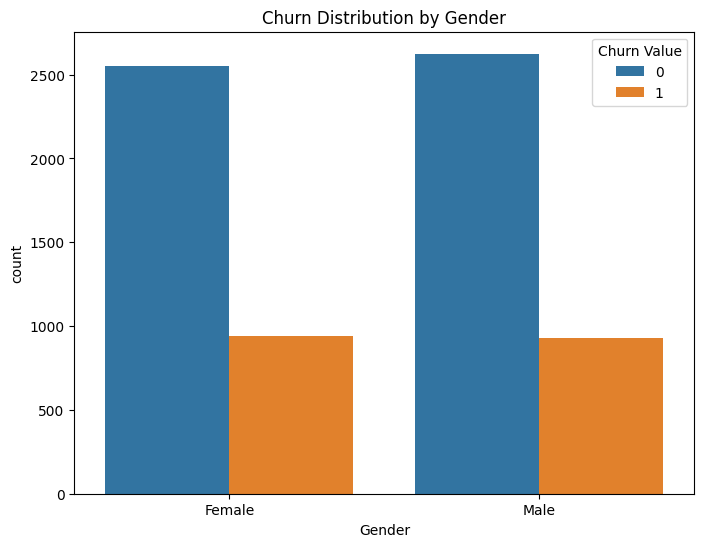

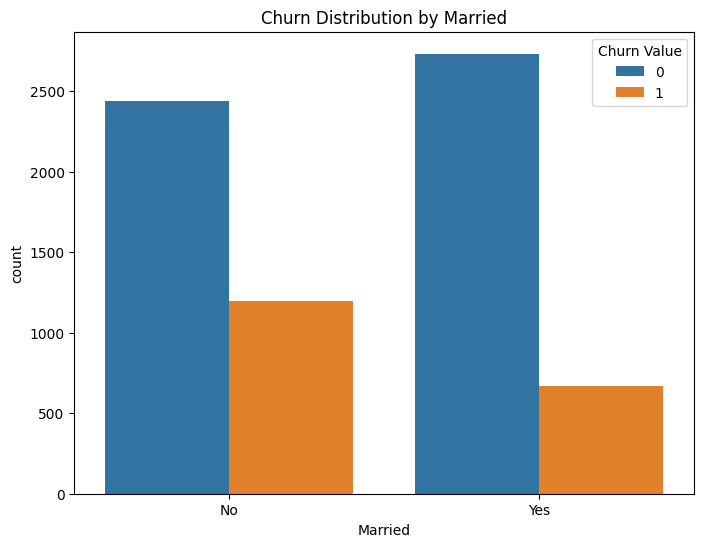

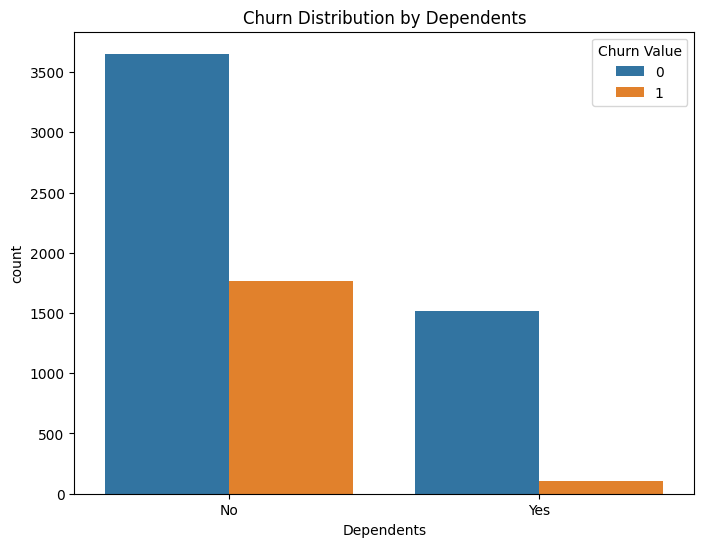

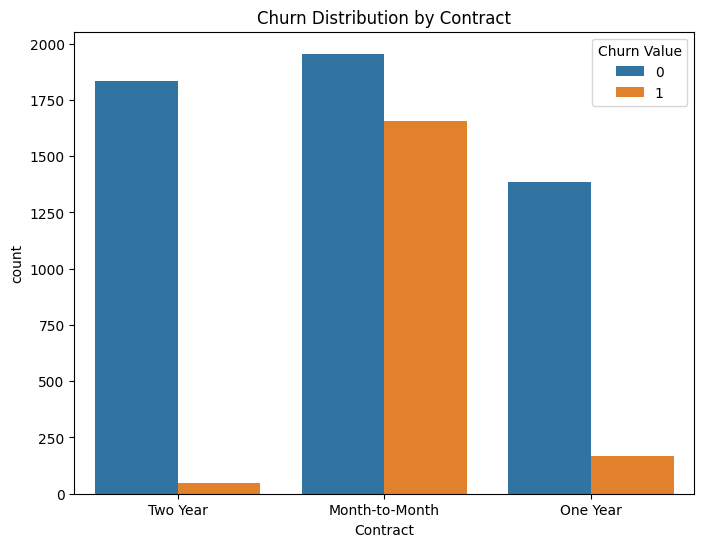

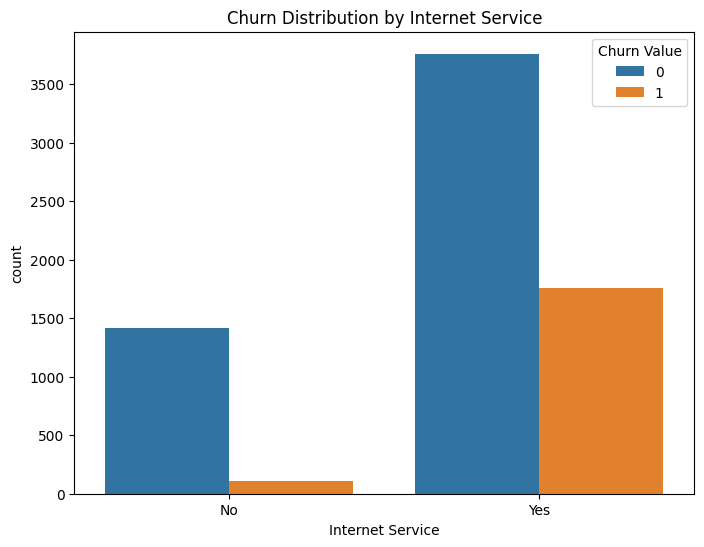

...

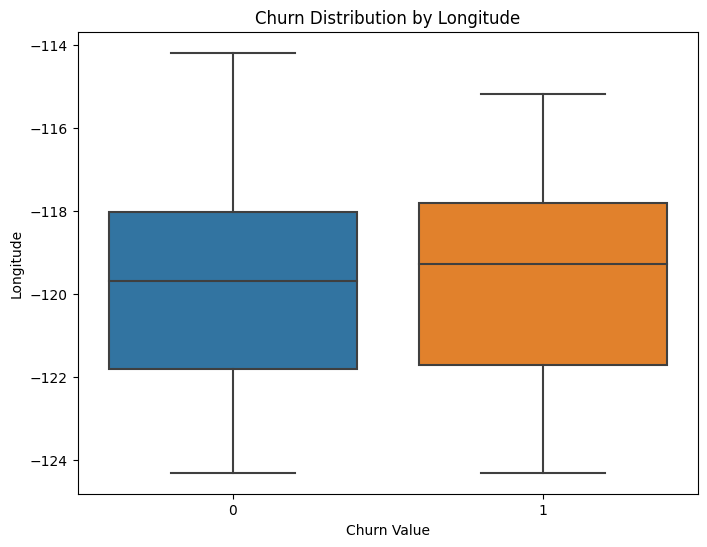

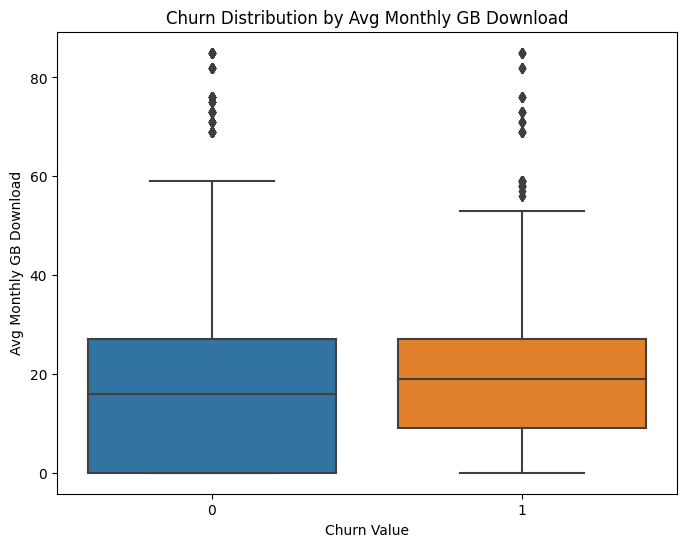

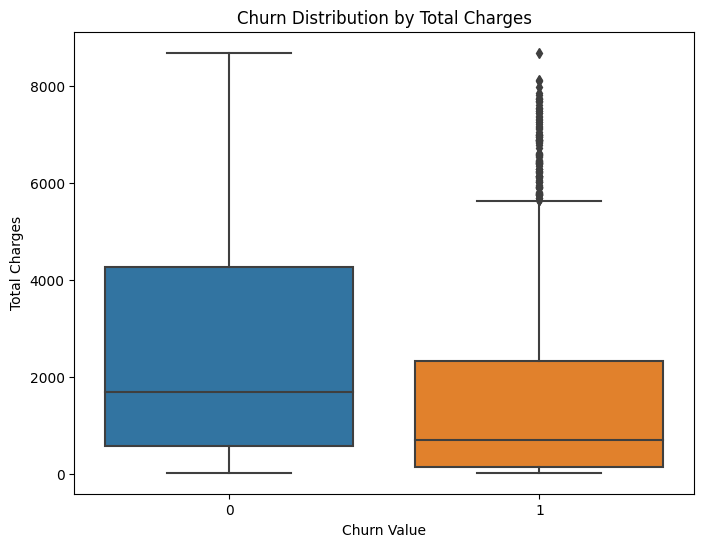

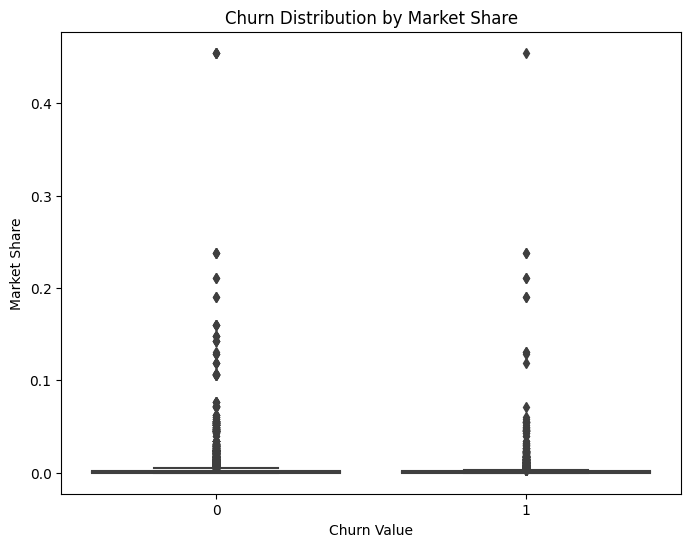

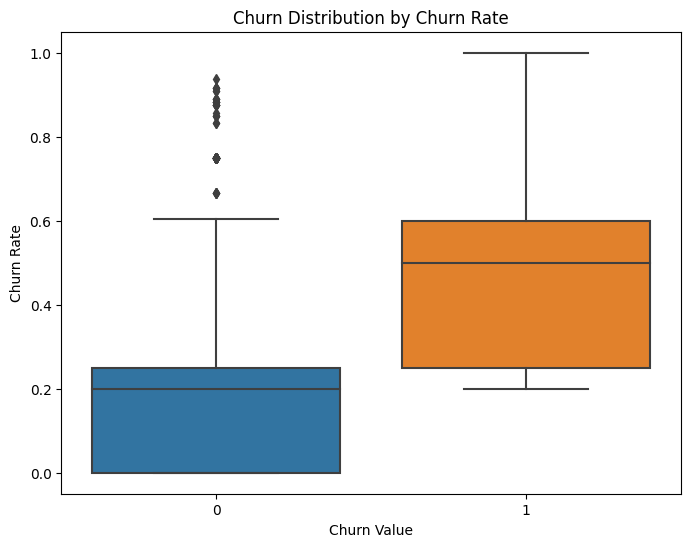

In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
data = df_rates.copy()
data.drop_duplicates(inplace = True)
# Calculate correlation matrix
# correlation_matrix = data.corr()


# Visualize churn distribution based on categorical features
categorical_columns = ['Gender', 'Married', 'Dependents', 'Contract', 'Internet Service', 'Offer', 'Referred a Friend', 
'Home Phone Service', 'Internet Type', 'Internet Service', 'Device Protection Plan', 'Contract', 'Unlimited Data']
for column in categorical_columns:
    plt.figure(figsize=(8, 6))
    sns.countplot(x=column, hue='Churn Value', data=data)
    plt.title(f'Churn Distribution by {column}')
    plt.show()

# Visualize churn distribution based on numerical features
numerical_columns = ['Age', 'Tenure in Months', 'Monthly Charge', 'Latitude', 'Longitude', 'Avg Monthly GB Download', 'Total Charges', 'Market Share', 'Churn Rate']
for column in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x='Churn Value', y=column, data=data)
    plt.title(f'Churn Distribution by {column}')
    plt.show()


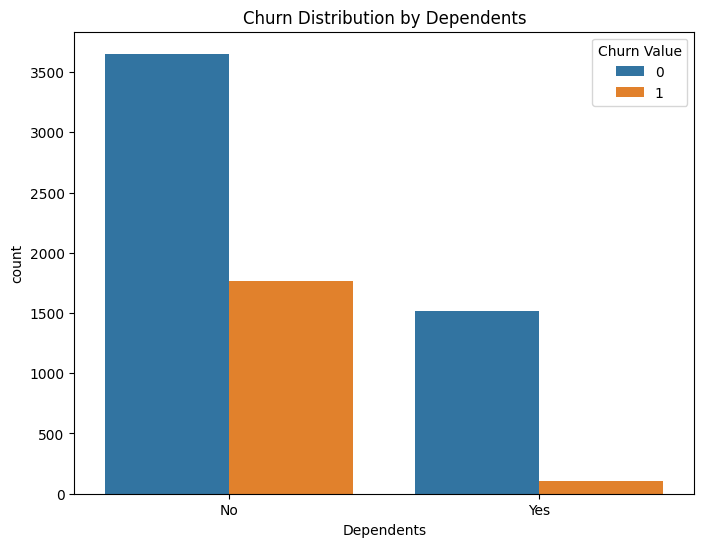

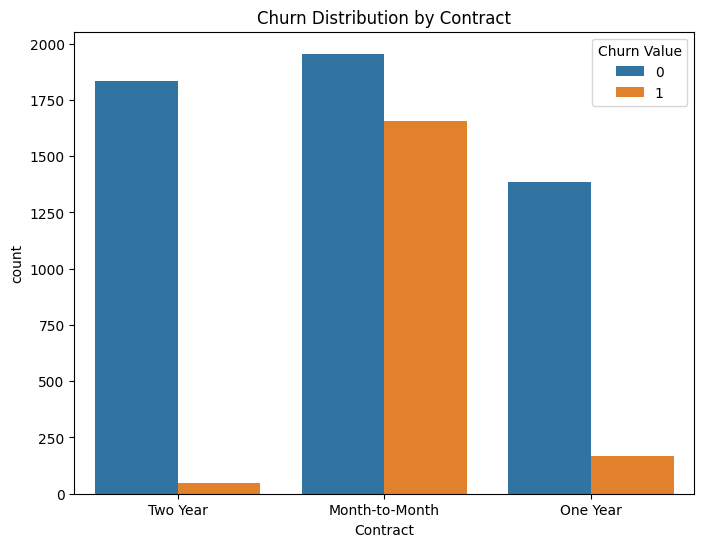

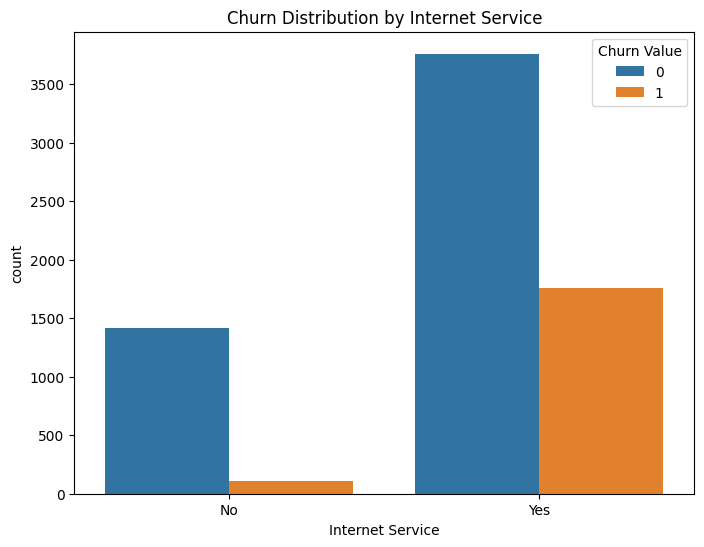

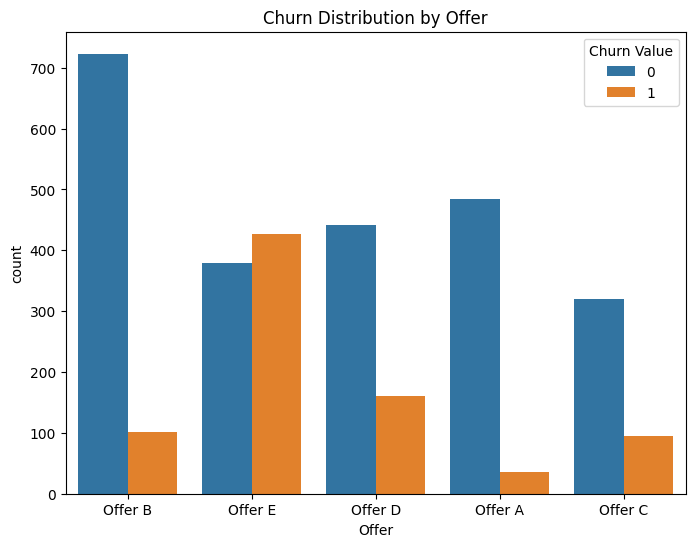

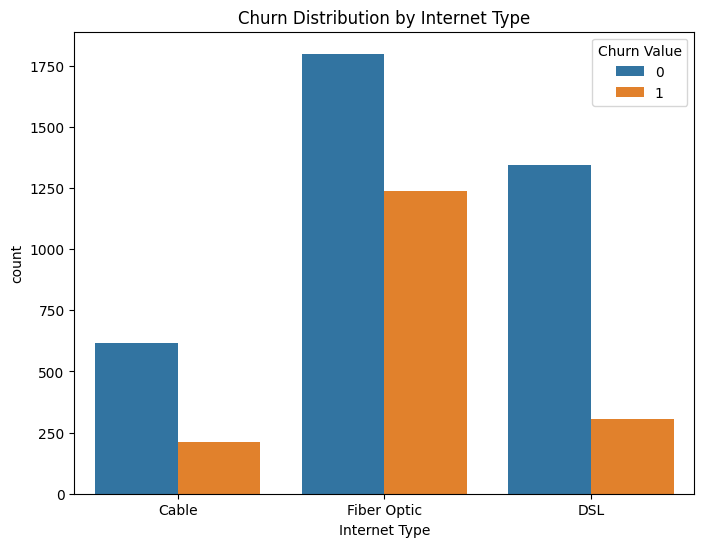

...

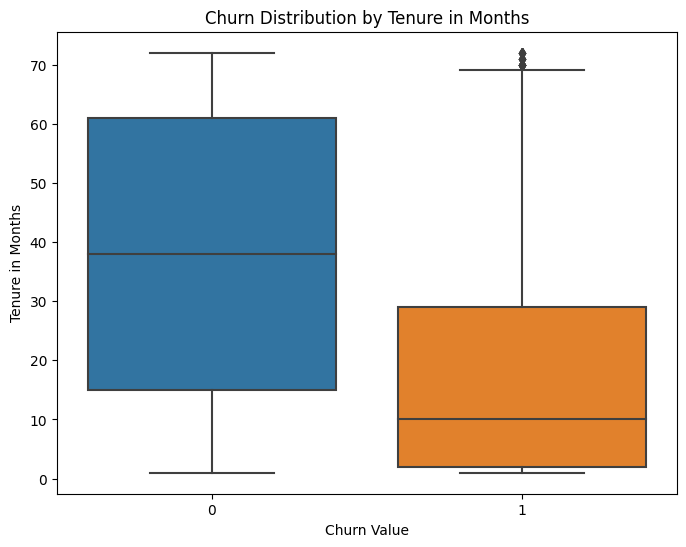

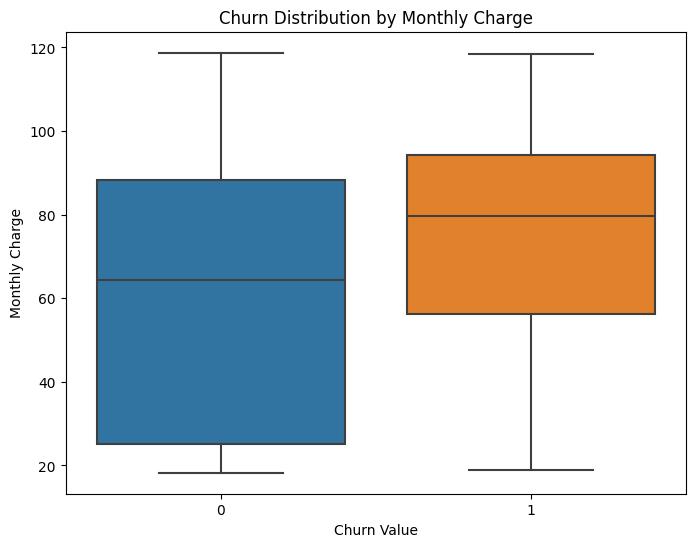

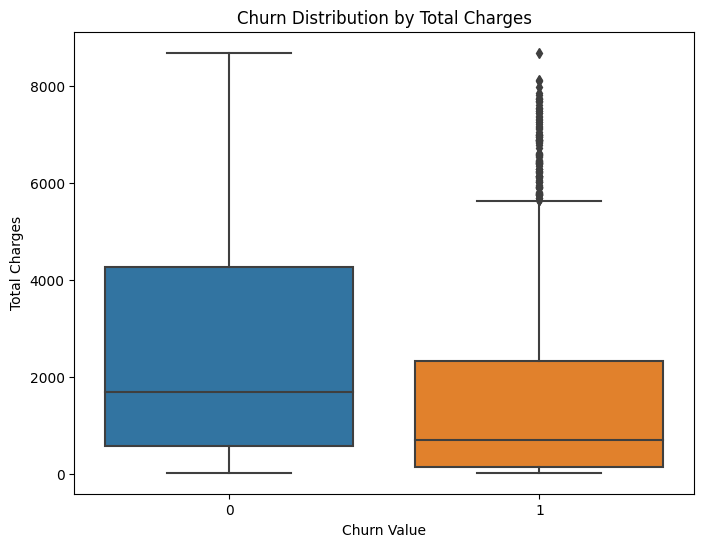

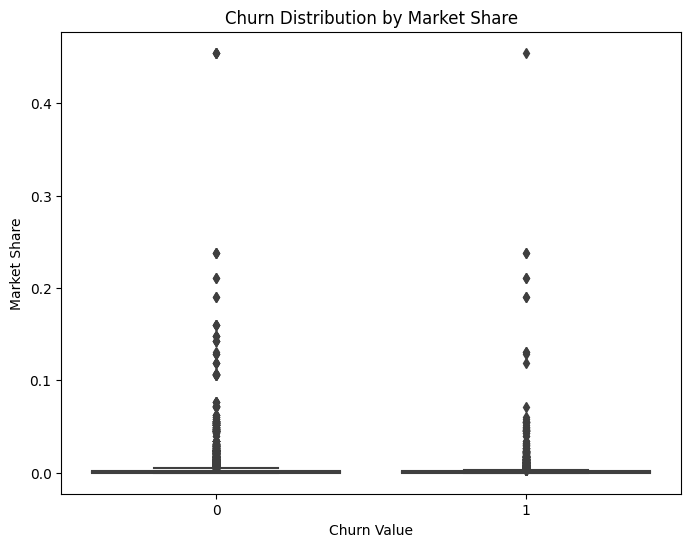

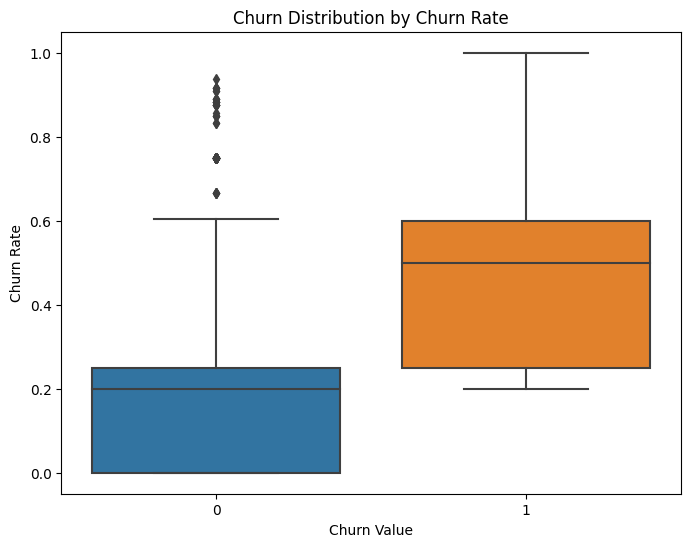

In [33]:
"""Selecting Columns/Featues
"""

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
columns = ['Customer ID','Dependents', 'Contract', 'Offer', 'Internet Type', 'Internet Service', 'Unlimited Data','Age', 'Tenure in Months', 'Monthly Charge', 'Total Charges', 'Market Share', 'Churn Rate', 'Churn Value']
data_selected = df_rates[columns]
# Calculate correlation matrix
# correlation_matrix = data.corr()


# Visualize churn distribution based on categorical features
categorical_columns = ['Dependents', 'Contract', 'Internet Service', 'Offer', 'Internet Type', 'Internet Service', 'Unlimited Data']
for column in categorical_columns:
    plt.figure(figsize=(8, 6))
    sns.countplot(x=column, hue='Churn Value', data=data_selected)
    plt.title(f'Churn Distribution by {column}')
    plt.show()

# Visualize churn distribution based on numerical features
numerical_columns = ['Age', 'Tenure in Months', 'Monthly Charge', 'Total Charges', 'Market Share', 'Churn Rate']
for column in numerical_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(x='Churn Value', y=column, data=data_selected)
    plt.title(f'Churn Distribution by {column}')
    plt.show()



In [35]:
encoded_df = data_selected.copy()

In [36]:
encoded_df

,Customer ID,Dependents,Contract,Offer,Internet Type,Internet Service,Unlimited Data,Age,Tenure in Months,Monthly Charge,Total Charges,Market Share,Churn Rate,Churn Value
0,4299-OPXEJ,No,Two Year,Offer B,NaN,No,No,57,56,19.55,1080.55,0.000133,0.2,0
1,3733-ZEECP,Yes,Month-to-Month,NaN,Cable,Yes,Yes,29,22,51.10,1232.90,0.000133,0.2,0
2,0278-YXOOG,No,Month-to-Month,Offer E,NaN,No,No,30,5,21.05,113.85,0.000133,0.2,1
3,4828-FAZPK,Yes,Month-to-Month,Offer D,Fiber Optic,Yes,Yes,30,16,79.95,1267.95,0.000133,0.2,0
4,1320-REHCS,No,Two Year,NaN,Fiber Optic,Yes,Yes,75,52,110.75,5832.00,0.000133,0.2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1363-TXLSL,No,Month-to-Month,Offer E,Fiber Optic,Yes,Yes,80,1,70.30,70.30,0.007678,0.5,1
7039,0323-XWWTN,Yes,Two Year,NaN,NaN,No,No,44,3,26.40,121.25,0.007678,0.5,0
7040,5373-SFODM,No,Month-to-Month,NaN,Fiber Optic,Yes,Yes,65,36,85.25,3132.75,0.007678,0.5,1
7041,0795-GMVQO,No,One Year,NaN,Fiber Optic,Yes,Yes,36,67,109.90,7332.40,0.000027,0.0,0


In [37]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
categorical_columns = ['Dependents', 'Contract', 'Internet Service', 'Offer', 'Internet Type', 'Unlimited Data']
encoded_df = data_selected.copy()
new_df = pd.DataFrame()
for col in categorical_columns:

    encoded_column = le.fit_transform(encoded_df[col])
    new_df[col] = pd.DataFrame(encoded_column)

    # Drop the old column from the original DataFrame
    encoded_df.drop(col, axis=1, inplace=True)

    # Concatenate the new DataFrame with the original DataFrame
    df = pd.concat([encoded_df, new_df], axis=1)
df

,Customer ID,Age,Tenure in Months,Monthly Charge,Total Charges,Market Share,Churn Rate,Churn Value,Dependents,Contract,Internet Service,Offer,Internet Type,Unlimited Data
0,4299-OPXEJ,57,56,19.55,1080.55,0.000133,0.2,0,0,2,0,1,3,0
1,3733-ZEECP,29,22,51.10,1232.90,0.000133,0.2,0,1,0,1,5,0,1
2,0278-YXOOG,30,5,21.05,113.85,0.000133,0.2,1,0,0,0,4,3,0
3,4828-FAZPK,30,16,79.95,1267.95,0.000133,0.2,0,1,0,1,3,2,1
4,1320-REHCS,75,52,110.75,5832.00,0.000133,0.2,0,0,2,1,5,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1363-TXLSL,80,1,70.30,70.30,0.007678,0.5,1,0,0,1,4,2,1
7039,0323-XWWTN,44,3,26.40,121.25,0.007678,0.5,0,1,2,0,5,3,0
7040,5373-SFODM,65,36,85.25,3132.75,0.007678,0.5,1,0,0,1,5,2,1
7041,0795-GMVQO,36,67,109.90,7332.40,0.000027,0.0,0,0,1,1,5,2,1


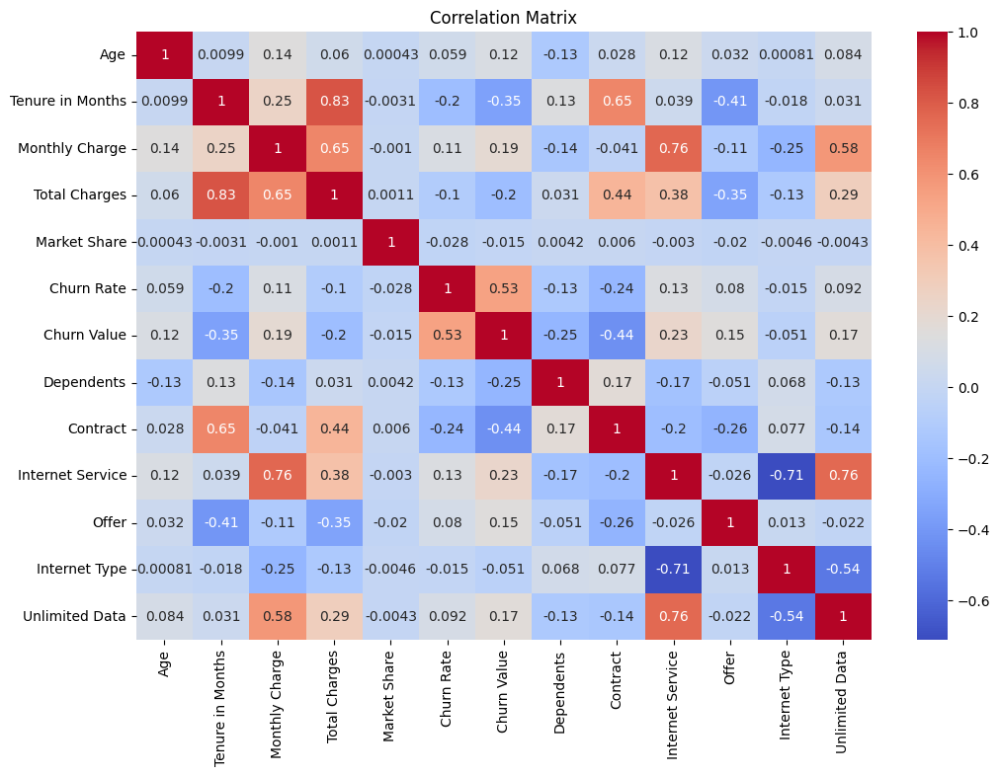

In [38]:
df_encoded = df.copy()
df_encoded.drop(['Customer ID'], axis = 1, inplace = True)
correlation_matrix = df_encoded.corr()

# Visualize correlation matrix using a heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Correlation Matrix")
plt.show()

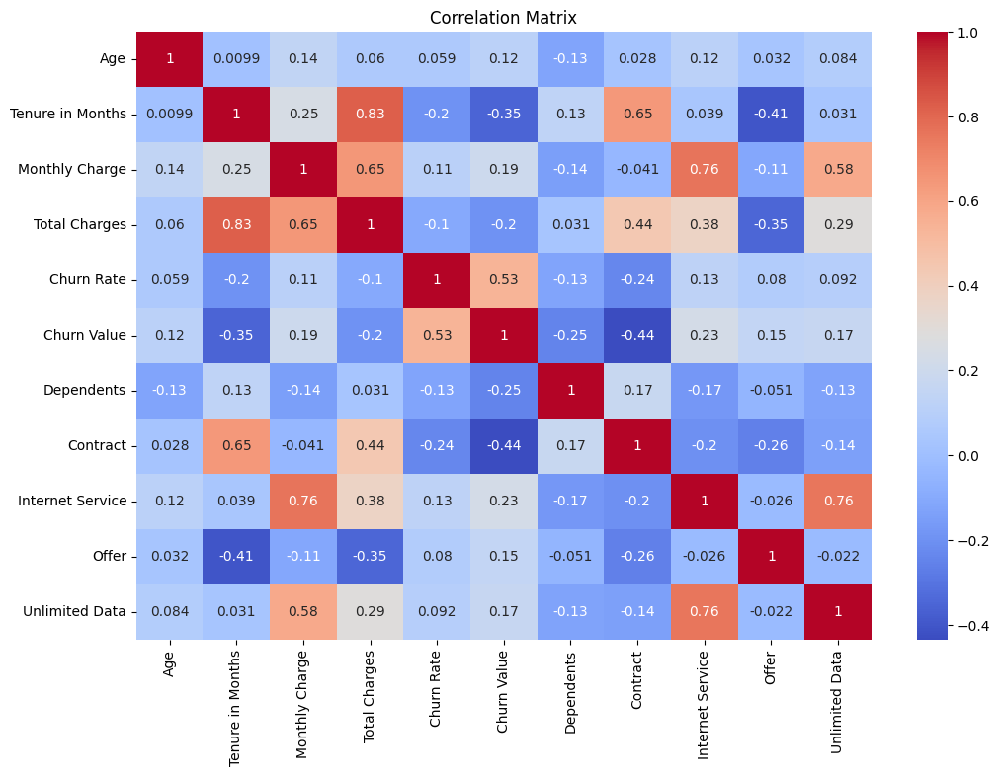

In [39]:
df_encoded.drop(['Market Share', 'Internet Type'], axis = 1, inplace = True)
correlation_matrix = df_encoded.corr()

# Visualize correlation matrix using a heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Correlation Matrix")
plt.show()


In [41]:
model_df = df_encoded.copy()

/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


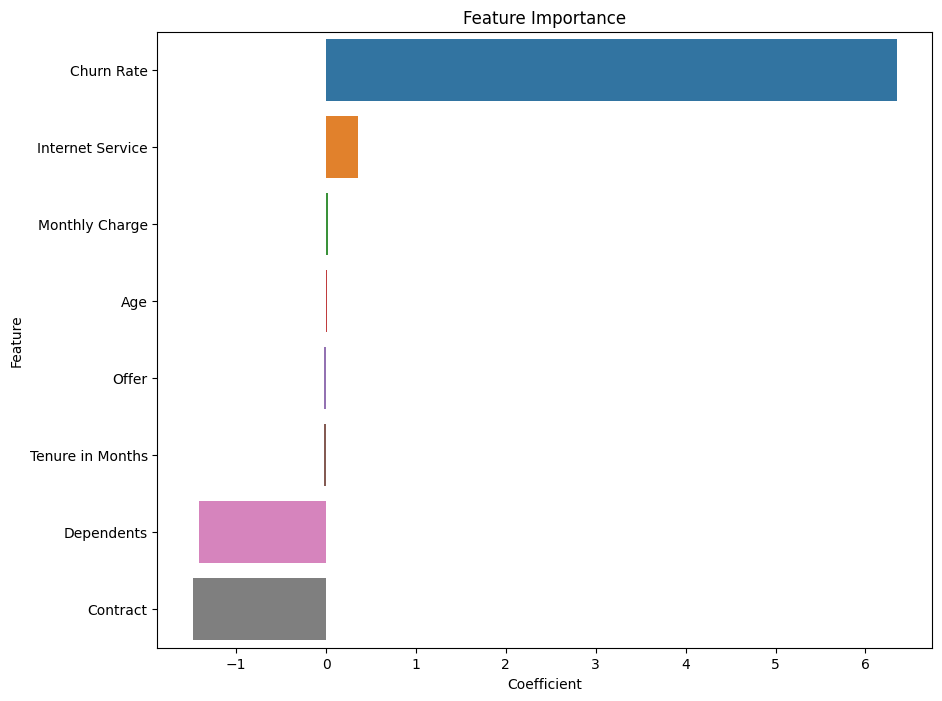

In [43]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
numerical_columns = ['Age', 'Tenure in Months', 'Monthly Charge', 'Total Charges', 'Churn Rate']
# model_df[numerical_columns] = scaler.fit_transform(model_df[numerical_columns])


# Assuming 'Churn Value' is the target variable
X = model_df.drop(['Churn Value', 'Total Charges', 'Unlimited Data'], axis=1)
y = model_df['Churn Value']

# Splitting data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Logistic Regression model
model = LogisticRegression()
model.fit(X_train, y_train)

# Get feature coefficients
feature_importance = pd.DataFrame({'Feature': X_train.columns, 'Coefficient': model.coef_[0]})
feature_importance = feature_importance.sort_values(by='Coefficient', ascending=False)

# Visualize feature importance
plt.figure(figsize=(10, 8))
sns.barplot(x='Coefficient', y='Feature', data=feature_importance)
plt.title("Feature Importance")
plt.show()

In [44]:
model_df

,Age,Tenure in Months,Monthly Charge,Total Charges,Churn Rate,Churn Value,Dependents,Contract,Internet Service,Offer,Unlimited Data
0,57,56,19.55,1080.55,0.2,0,0,2,0,1,0
1,29,22,51.10,1232.90,0.2,0,1,0,1,5,1
2,30,5,21.05,113.85,0.2,1,0,0,0,4,0
3,30,16,79.95,1267.95,0.2,0,1,0,1,3,1
4,75,52,110.75,5832.00,0.2,0,0,2,1,5,1
...,...,...,...,...,...,...,...,...,...,...,...
7038,80,1,70.30,70.30,0.5,1,0,0,1,4,1
7039,44,3,26.40,121.25,0.5,0,1,2,0,5,0
7040,65,36,85.25,3132.75,0.5,1,0,0,1,5,1
7041,36,67,109.90,7332.40,0.0,0,0,1,1,5,1


In [45]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score

# Assuming you have preprocessed data X and binary target variable y

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest classifier
# model = LogisticRegression()
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Predict churn probabilities
churn_probabilities = model.predict_proba(X_test)[:, 1]

# Calculate churn risk value (probability) for each customer
churn_risk_values = churn_probabilities

# Calculate ROC-AUC score to evaluate model performance



### Final Metrics

In [46]:
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import classification_report
from sklearn.metrics import cohen_kappa_score


kappa = cohen_kappa_score(y_test, model.predict(X_test))


report = classification_report(y_test, model.predict(X_test))


roc_auc = roc_auc_score(y_test, churn_probabilities)
precision = precision_score(y_test, model.predict(X_test))
recall = recall_score(y_test, model.predict(X_test))
f1 = f1_score(y_test, model.predict(X_test))
print("Cohen's Kappa:", kappa)
print("Classification Report:")
print(report)
print("ROC-AUC:", roc_auc)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)

Cohen's Kappa: 0.6947530614939501
Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.92      0.92      1032
           1       0.77      0.78      0.78       377

    accuracy                           0.88      1409
   macro avg       0.85      0.85      0.85      1409
weighted avg       0.88      0.88      0.88      1409

ROC-AUC: 0.9372840972179385
Precision: 0.7736842105263158
Recall: 0.7798408488063661
F1-Score: 0.7767503302509907


In [47]:
churn_risk_value = model.predict_proba(X)[:, 1]
churn_risk_value

array([0.  , 0.02, 0.67, ..., 0.97, 0.  , 0.  ])

In [51]:
len(churn_risk_value)
chirn_risk = pd.DataFrame({'Churn Risk Value': churn_risk_value})
final_df = pd.concat([encoded_df, chirn_risk], axis=1)
final_df

,Customer ID,Age,Tenure in Months,Monthly Charge,Total Charges,Market Share,Churn Rate,Churn Value,Churn Risk Value
0,4299-OPXEJ,57,56,19.55,1080.55,0.000133,0.2,0,0.00
1,3733-ZEECP,29,22,51.10,1232.90,0.000133,0.2,0,0.02
2,0278-YXOOG,30,5,21.05,113.85,0.000133,0.2,1,0.67
3,4828-FAZPK,30,16,79.95,1267.95,0.000133,0.2,0,0.09
4,1320-REHCS,75,52,110.75,5832.00,0.000133,0.2,0,0.01
...,...,...,...,...,...,...,...,...,...
7038,1363-TXLSL,80,1,70.30,70.30,0.007678,0.5,1,1.00
7039,0323-XWWTN,44,3,26.40,121.25,0.007678,0.5,0,0.01
7040,5373-SFODM,65,36,85.25,3132.75,0.007678,0.5,1,0.97
7041,0795-GMVQO,36,67,109.90,7332.40,0.000027,0.0,0,0.00


In [52]:
final_df = pd.concat([data, chirn_risk], axis=1)
final_df

,Customer ID,State,City,Zip Code,Latitude,Longitude,Gender,Age,Married,Dependents,...,Satisfaction Score,Customer Status,Churn Value,Churn Category,Churn Reason,Population,Customer Count,Market Share,Churn Rate,Churn Risk Value
0,4299-OPXEJ,California,Inglewood,90301,33.956445,-118.358634,Female,57,No,No,...,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2,0.00
1,3733-ZEECP,California,Inglewood,90301,33.956445,-118.358634,Male,29,Yes,Yes,...,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2,0.02
2,0278-YXOOG,California,Inglewood,90301,33.956445,-118.358634,Male,30,No,No,...,3,Churned,1,Attitude,Attitude of support person,37527.0,5,0.000133,0.2,0.67
3,4828-FAZPK,California,Inglewood,90301,33.956445,-118.358634,Female,30,Yes,Yes,...,4,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2,0.09
4,1320-REHCS,California,Inglewood,90301,33.956445,-118.358634,Male,75,No,No,...,5,Stayed,0,NaN,NaN,37527.0,5,0.000133,0.2,0.01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7038,1363-TXLSL,California,San Lucas,93954,36.125529,-120.864443,Male,80,Yes,No,...,1,Churned,1,Competitor,Competitor had better devices,521.0,4,0.007678,0.5,1.00
7039,0323-XWWTN,California,San Lucas,93954,36.125529,-120.864443,Male,44,No,Yes,...,5,Joined,0,NaN,NaN,521.0,4,0.007678,0.5,0.01
7040,5373-SFODM,California,San Lucas,93954,36.125529,-120.864443,Male,65,Yes,No,...,2,Churned,1,Dissatisfaction,Product dissatisfaction,521.0,4,0.007678,0.5,0.97
7041,0795-GMVQO,California,San Diego,92105,32.741859,-117.090353,Male,36,Yes,No,...,4,Stayed,0,NaN,NaN,73006.0,2,0.000027,0.0,0.00


/Users/saragolestani/Library/Python/3.9/lib/python/site-packages/pandas/plotting/_matplotlib/core.py:1258: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


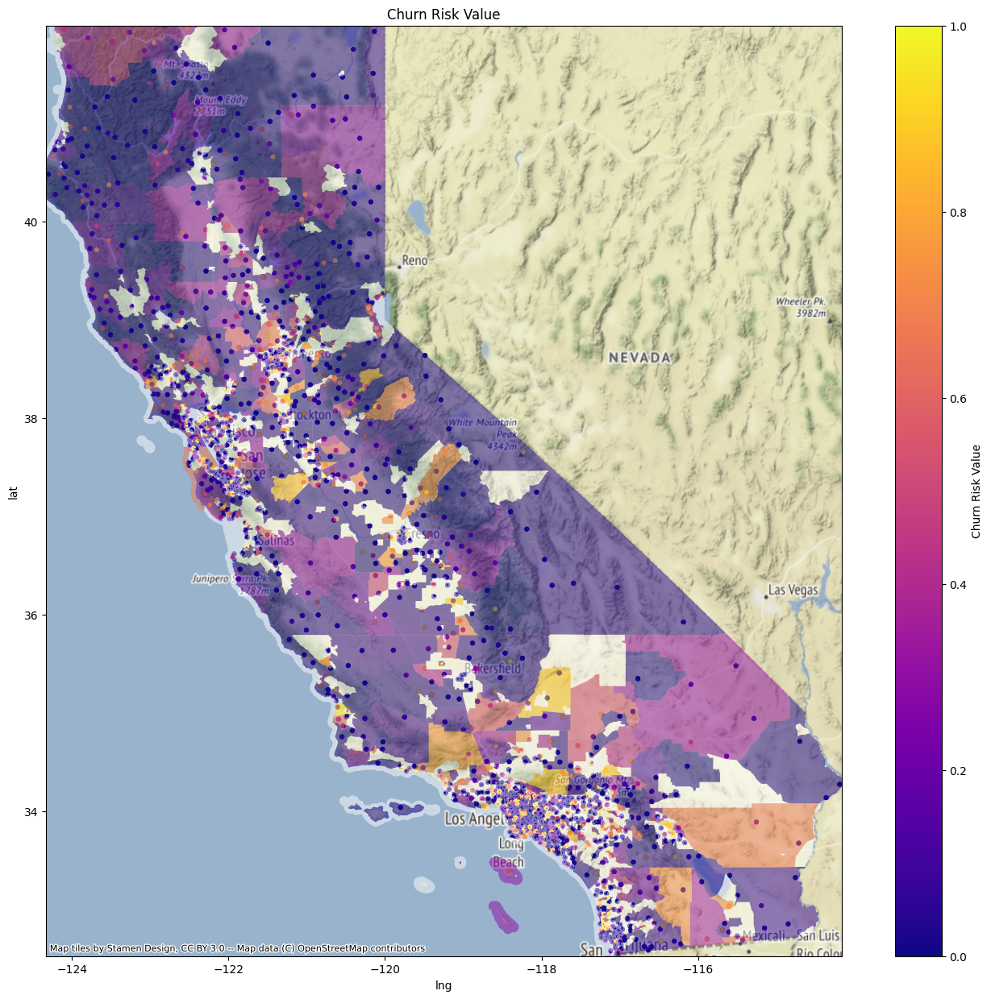

In [53]:
spatial_plot(final_df, 'Churn Risk Value', None)